In [1]:
import os
from datetime import datetime

import math
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
import imutils
from tqdm import tqdm_notebook as tqdm
import warnings

In [2]:
CROP_SIZE = 300
MARGIN = 0.35
image_dir = 'C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female'
result_dir = './results'

lbp_xml = "./models/lbpcascade_frontalface_improved.xml"
eye_xml = "./models/haarcascade_eye.xml"

file_list = []

for root, directories, files in os.walk(image_dir):
    for file in files:
        file_list.append(os.path.join(root, file))
        
print(len(file_list))

966


In [3]:
def rotate_points(x_coords, y_coords, shape, theta):
    n = len(x_coords)
    if n != len(y_coords):
        raise ValueError("The number of x and y coordinates are not equal.") #wrap?
    if n == 0:
        raise ValueError("Coordinate lists are empty")

    (height, width) = shape
    (centerX, centerY) = (width // 2, height // 2)

    #Transform each corner of the rectangle
    M = cv2.getRotationMatrix2D((centerX, centerY), theta, 1.0)
    shift = M[:, 2]
    rect = np.array([x_coords, y_coords, [1] * n ])
    new_rect = np.dot(M, rect)

    #Format the points to draw polylines 
    pts = [[new_rect[0, i], new_rect[1, i]] for i in range(-1, n)]
    pts = np.array(pts, np.int32)
    pts.reshape((-1, 1, 2))
    return pts

def point_angle_line(x, y, theta, low, high):
    #Calculate the lengths from the change in y
    length_1 = (low - y) / np.sin(theta)
    length_2 = (high - y) / np.sin(theta)

    #Calculate delta_x's 
    delta_x_1 = int(length_1 * np.cos(theta))
    delta_x_2 = int(length_2 * np.cos(theta))

    #Return new points
    p1 = (x + delta_x_1, low)
    p2 = (x + delta_x_2, high)  
    return p1, p2

107 107
517 517


C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\matplotlib\figure.py:98: MatplotlibDeprecationWarning: 
Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  "Adding an axes using the same arguments as a previous axes "


287 287
235 235
239 239
93 93
287 287
191 191
243 243
113 113
204 204
260 260
114 114
292 292
192 192
204 204
401 401
326 326
323 323
182 182


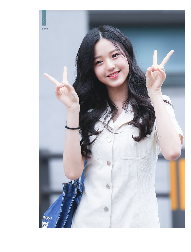

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\115.jpg


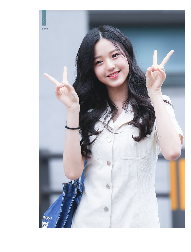

255 255
170 170


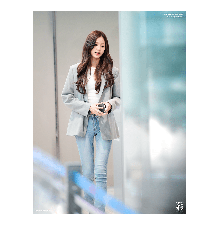

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\117.png


90 90
317 317


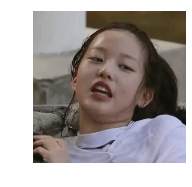

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\119.jpg


444 444


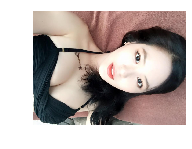

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\11990612_429556123897570_3573110387112444243_n.jpg


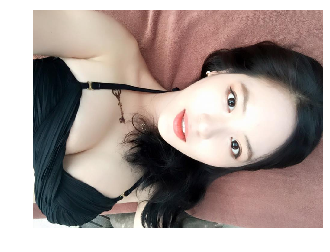

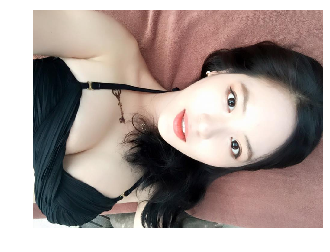

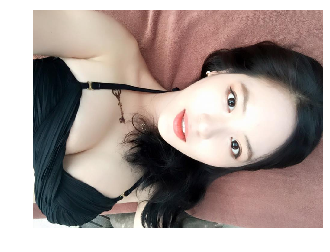

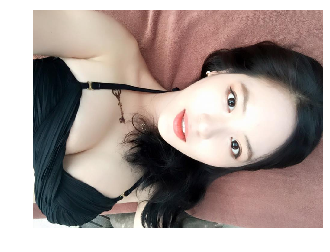

449 449


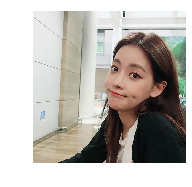

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\12.jpg


370 370
200 200
284 284
374 374
249 249


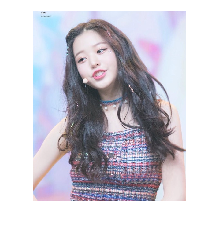

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\123.jpg


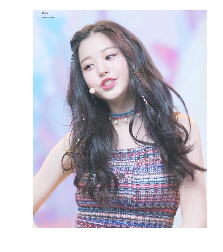

210 210
235 235


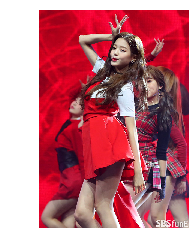

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\125.jpg


132 132
409 409
231 231
425 425
151 151


C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:81: RuntimeWarning: divide by zero encountered in int_scalars


239 239
234 234
238 238
182 182


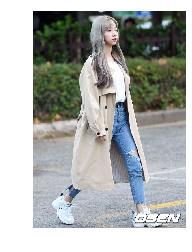

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\135.jpg


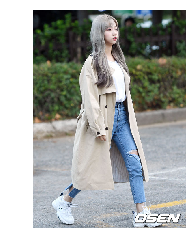

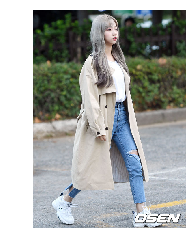

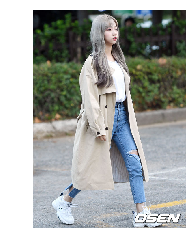

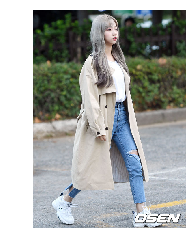

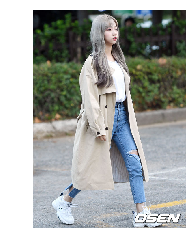

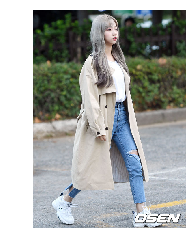

361 361
195 195
571 571
185 185


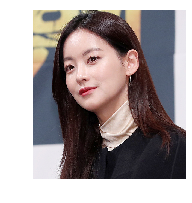

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\14.jpg


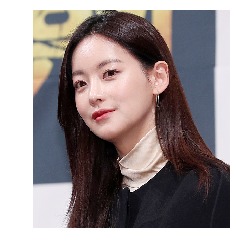

287 287


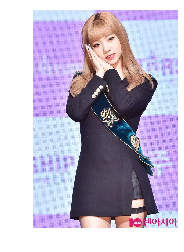

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\140.jpg


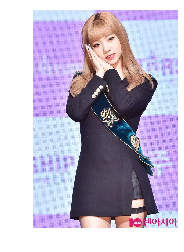

170 170
430 430
152 152
113 113
238 238


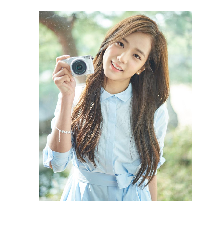

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\145.jpg


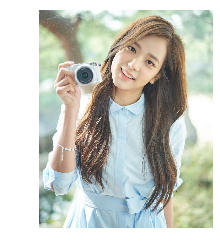

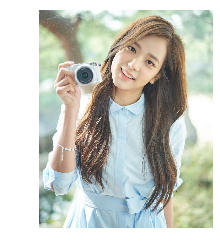

371 371


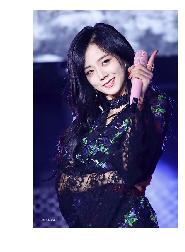

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\146.jpg


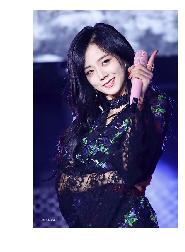

254 254
224 224
90 90
263 263
288 288
278 278
312 312
452 452
293 293
123 123
172 172
206 206


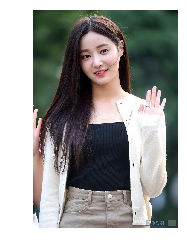

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\158.jpg


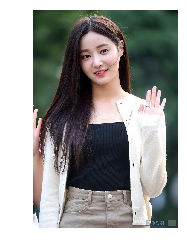

243 243
273 273
142 142
187 187
321 321


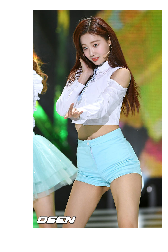

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\162.jpg


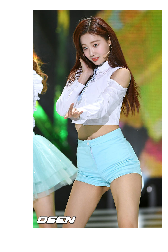

138 138
323 323
230 230
137 137
259 259
157 157
458 458
158 158
346 346
98 98


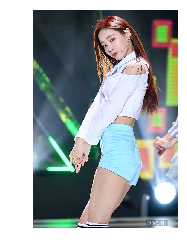

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\171.jpg


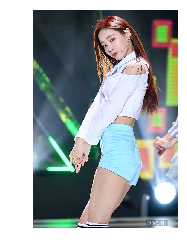

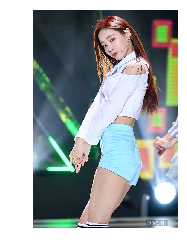

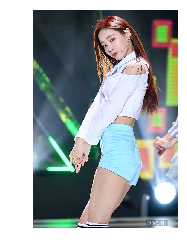

175 175
201 201
209 209
278 278
238 238
88 88
210 210
93 93
307 307
146 146
326 326
255 255
108 108
294 294
284 284
221 221
186 186
289 289
604 604
157 157
512 512
158 158


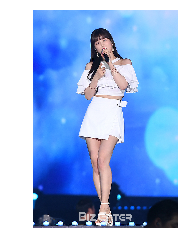

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\193.jpg


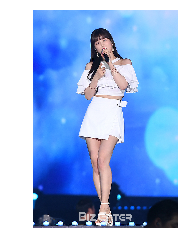

90 90


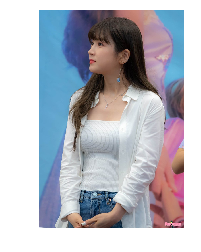

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\194.jpg


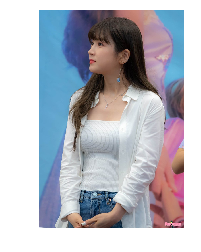

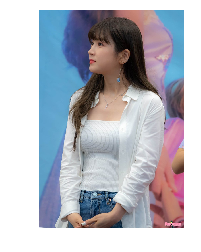

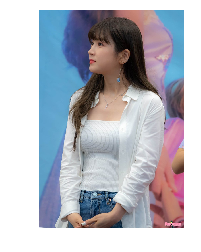

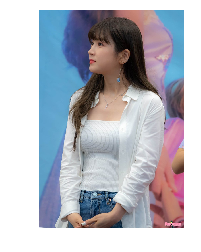

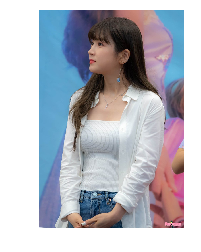

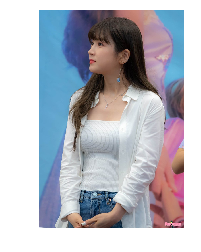

481 481
408 408
376 376
157 157
254 254
380 380
384 384


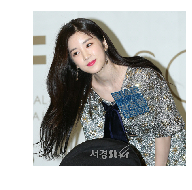

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\200.jpg


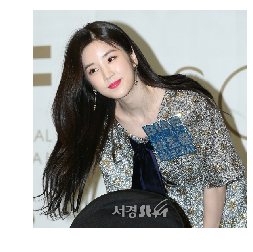

171 171


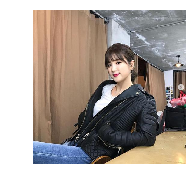

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\201.jpg


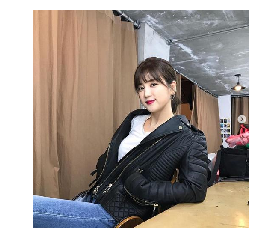

88 88
517 517
510 510
196 196
311 311
380 380
258 258
171 171


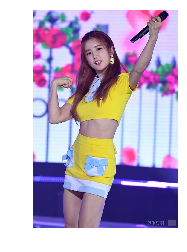

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\208.jpg


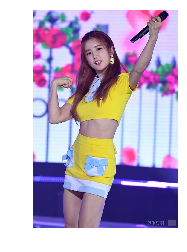

156 156


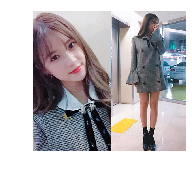

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\209.jpg


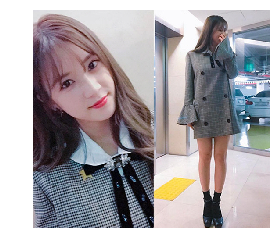

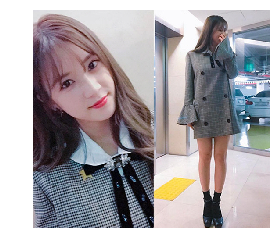

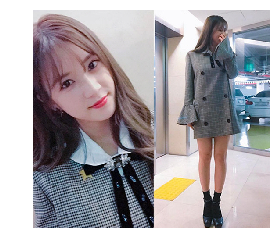

216 216
273 273
395 395
195 195
229 229
345 345


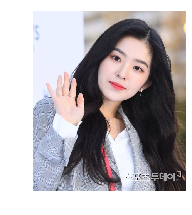

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\214.jpg


258 258
187 187


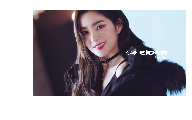

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\216.jpg


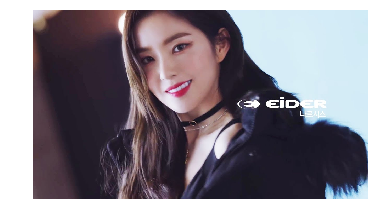

454 454
478 478
200 200
637 637
238 238
303 303
107 107
245 245
209 209
467 467
264 264
158 158
158 158
658 658
273 273


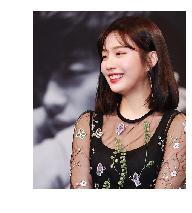

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\228.jpg


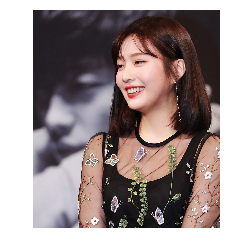

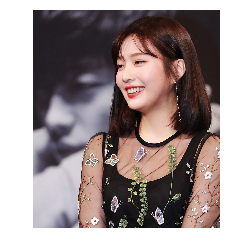

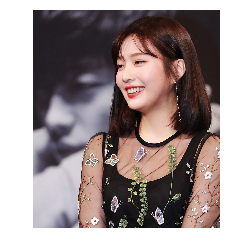

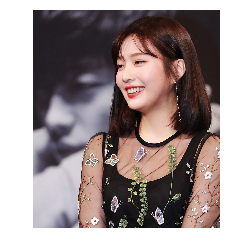

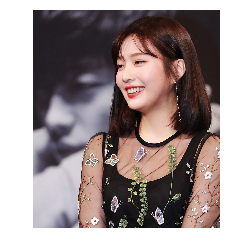

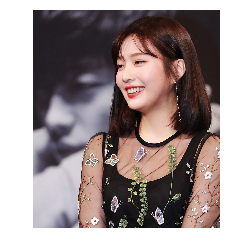

316 316
196 196


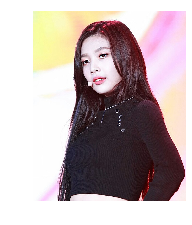

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\230.jpg


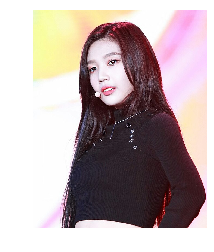

249 249
245 245
143 143
170 170
234 234
323 323
245 245
171 171
152 152
163 163
244 244
176 176
83 83
413 413
177 177


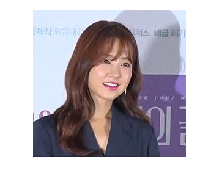

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\244.jpg


98 98
180 180
230 230


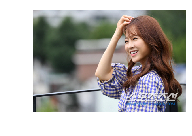

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\247.jpg


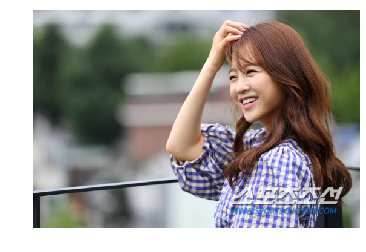

108 108
254 254
195 195
255 255
176 176


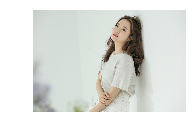

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\251.JPG


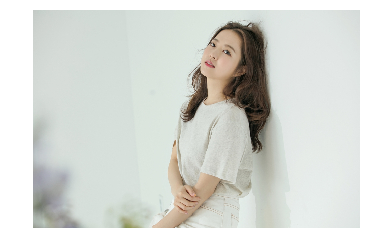

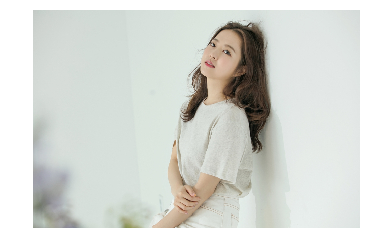

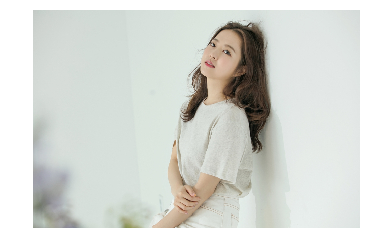

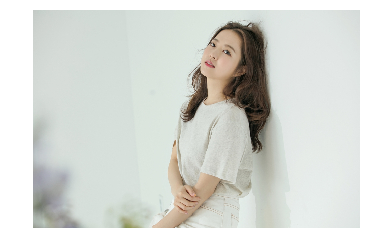

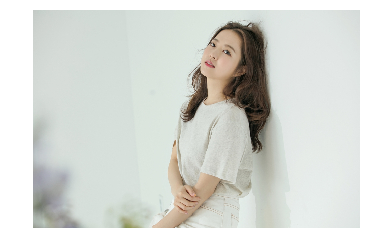

225 225
442 442


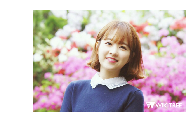

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\253.jpg


192 192
136 136
221 221
176 176
458 458
277 277
316 316


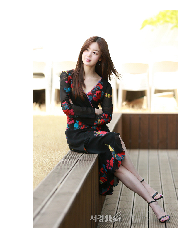

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\26.jpg


112 112
127 127
153 153
367 367
195 195
186 186
177 177
278 278
356 356
191 191
303 303
197 197
284 284
312 312
219 219
284 284
137 137


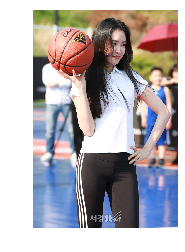

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\274.jpg


163 163
187 187
263 263


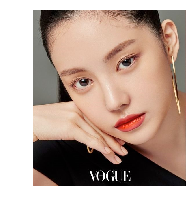

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\277.jpg


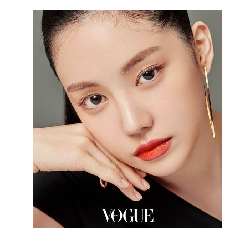

526 526
288 288
284 284
337 337
287 287
166 166
226 226
341 341
433 433
124 124
84 84
501 501
311 311
263 263
166 166
328 328


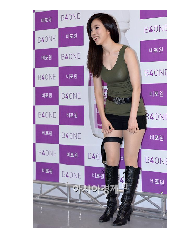

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\292.jpg


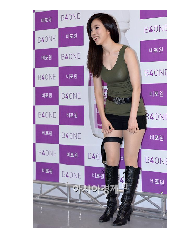

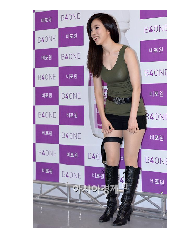

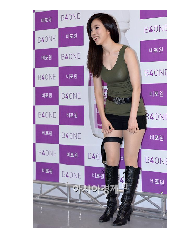

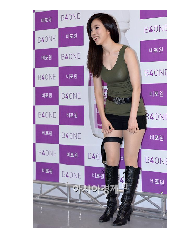

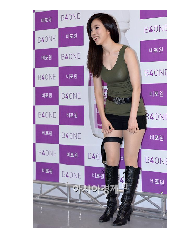

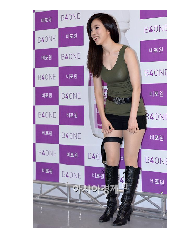

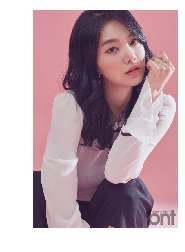

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\293.jpg


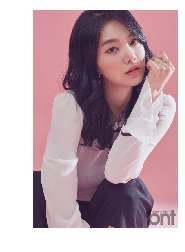

264 264
128 128
191 191
313 313
263 263
112 112
337 337
268 268
311 311
809 809


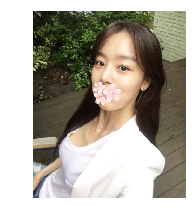

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\30.png


216 216
418 418
127 127
166 166
167 167
190 190
209 209
283 283
177 177
148 148
530 530
515 515
197 197
156 156
206 206
180 180
287 287
287 287
219 219
176 176
1108 1108
129 129
491 491
792 792
342 342
221 221
1342 1342


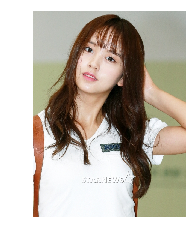

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\324.jpg


239 239
464 464
209 209


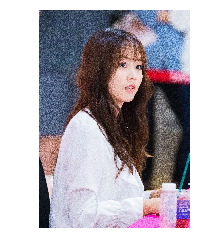

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\327.jpg


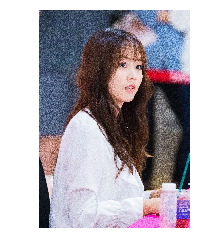

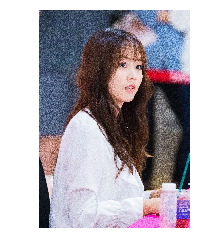

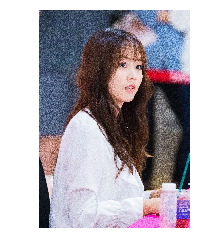

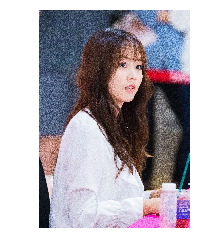

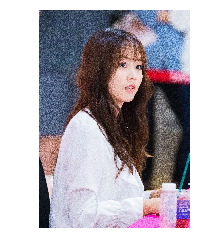

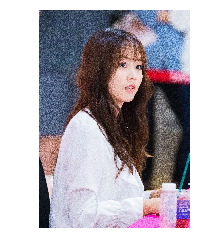

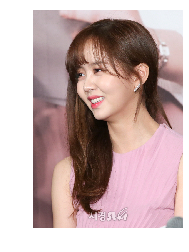

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\328.jpg


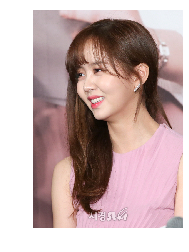

226 226
185 185


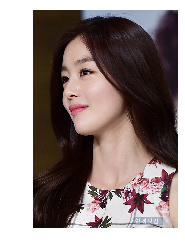

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\33.jpg


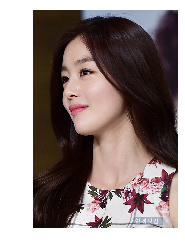

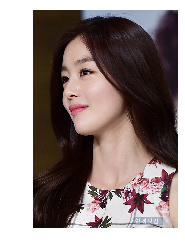

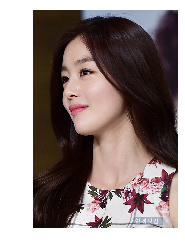

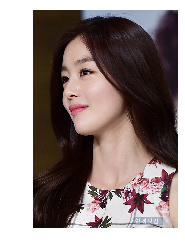

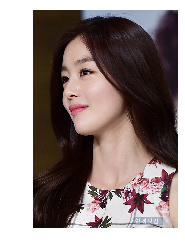

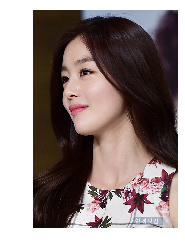

239 239
138 138
337 337


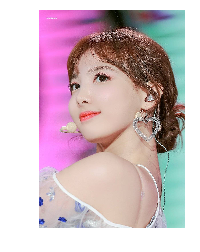

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\333.jpg


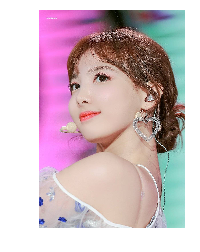

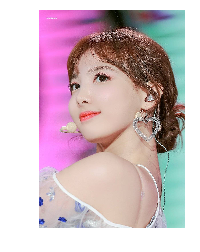

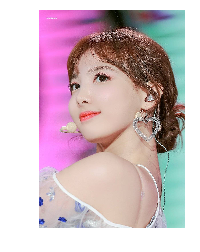

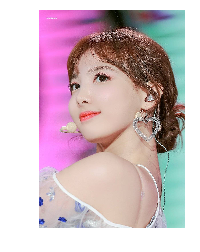

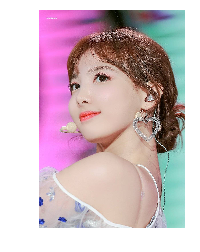

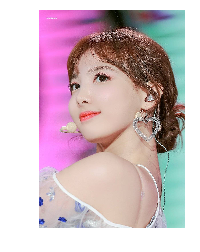

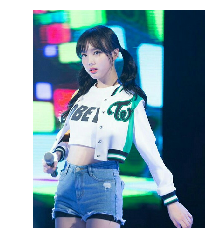

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\334.jpg


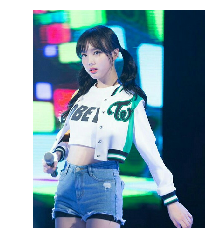

132 132
345 345
204 204
95 95


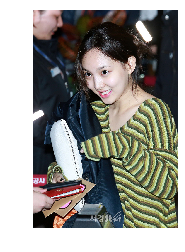

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\338.jpg


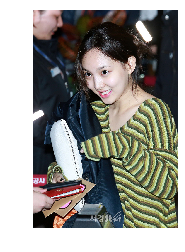

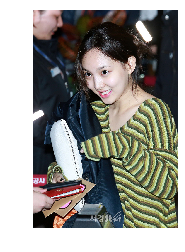

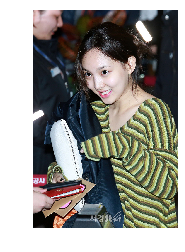

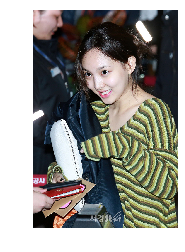

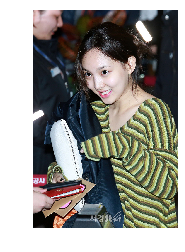

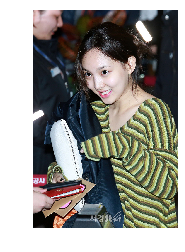

346 346


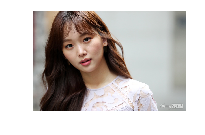

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\34.jpg


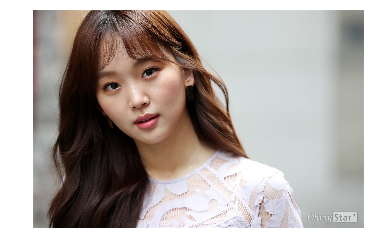

346 346
298 298
204 204


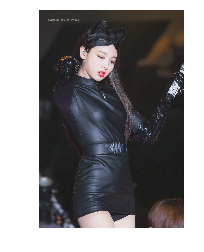

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\342.jpg


258 258
146 146
331 331
231 231
263 263


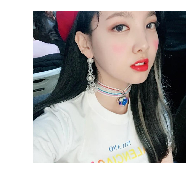

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\347.jpg


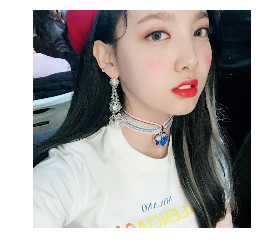

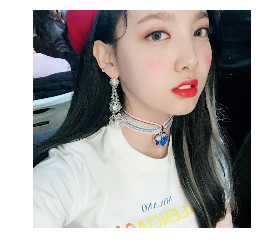

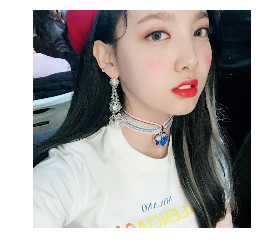

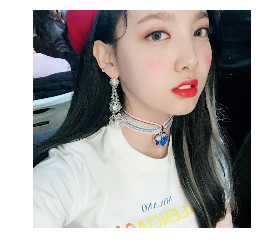

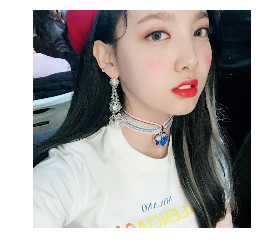

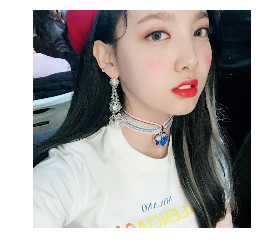

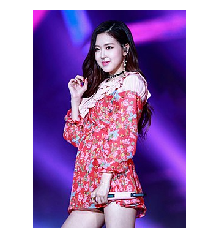

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\348.jpg


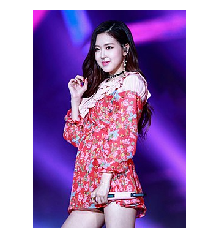

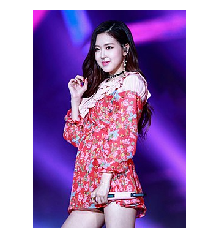

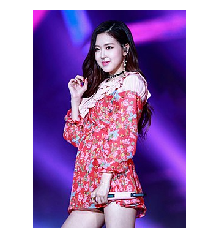

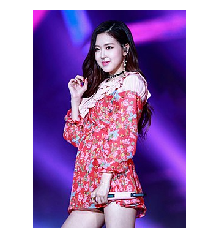

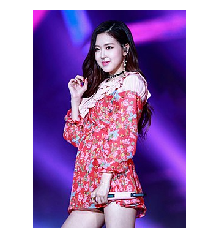

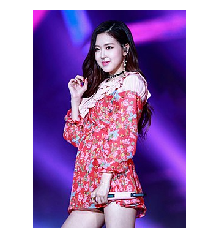

128 128


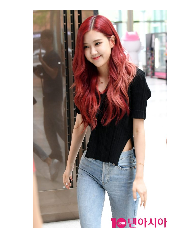

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\350.jpg


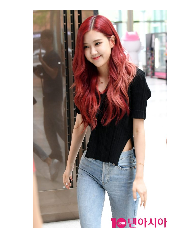

153 153
245 245
89 89
235 235
182 182
254 254
214 214
112 112
216 216
331 331
263 263


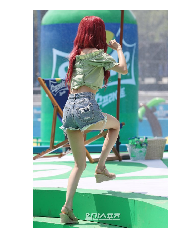

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\360.jpeg


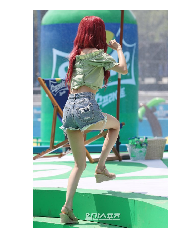

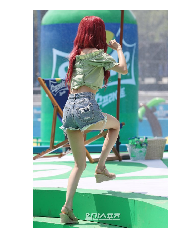

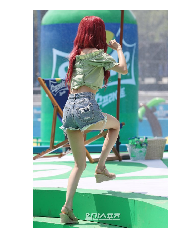

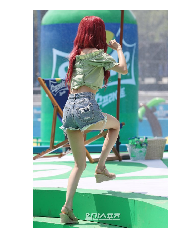

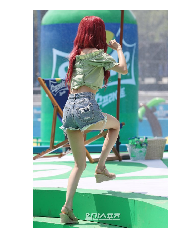

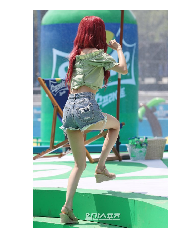

210 210
219 219
210 210
152 152
166 166


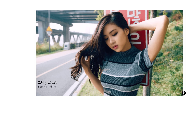

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\365.jpg


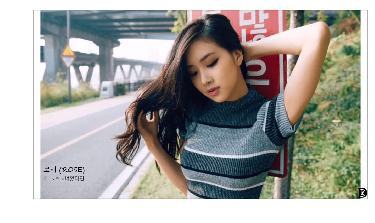

211 211
316 316
191 191
80 80
355 355


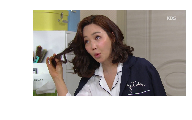

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\369.jpg


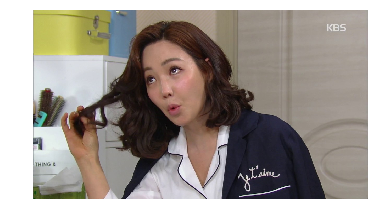

284 284
162 162
162 162
195 195
420 420
510 510
253 253
143 143
498 498
326 326
204 204
885 885
185 185
230 230
254 254


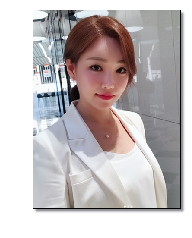

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\382.jpg


172 172
250 250
95 95


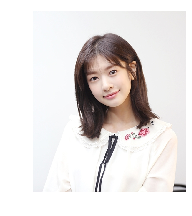

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\385.jpg


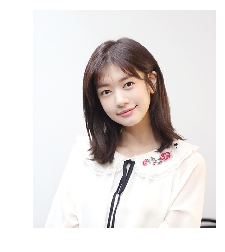

204 204
260 260
298 298


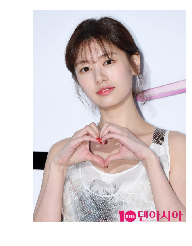

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\388.jpg


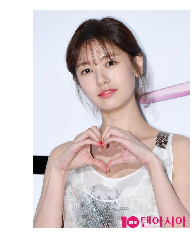

268 268


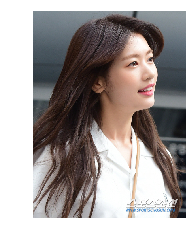

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\389.jpg


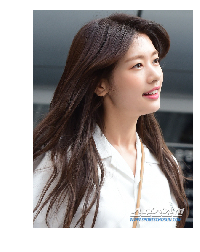

215 215
162 162
527 527
167 167


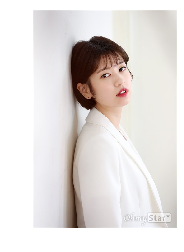

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\392.jpg


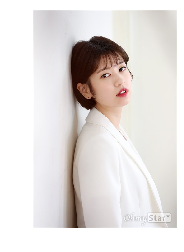

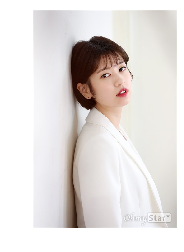

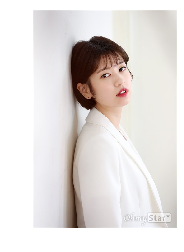

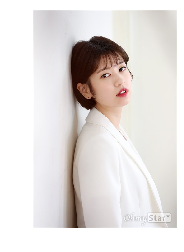

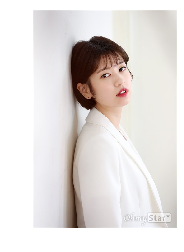

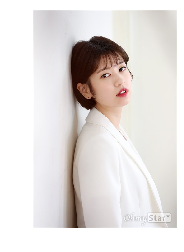

288 288
171 171
182 182
282 282


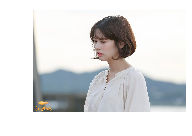

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\396.jpg


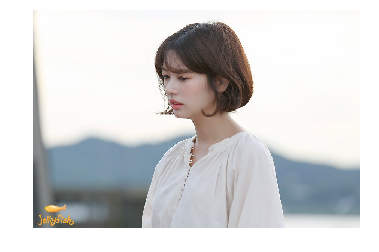

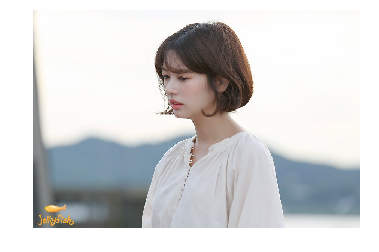

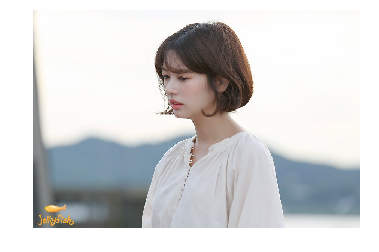

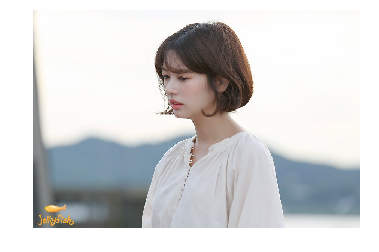

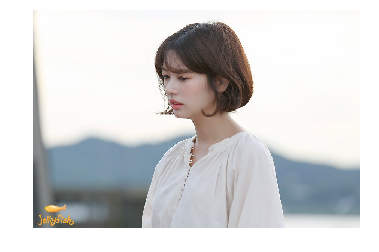

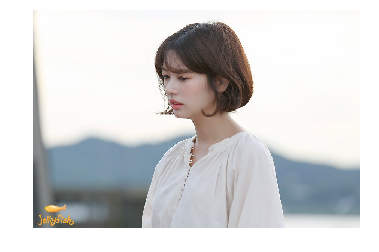

214 214


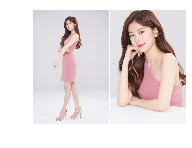

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\398.jpg


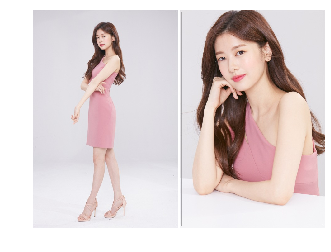

196 196
234 234
424 424


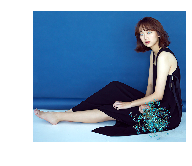

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\40.jpg


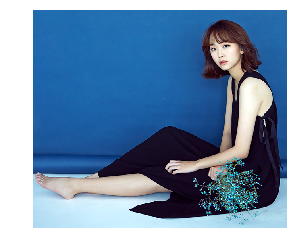

102 102


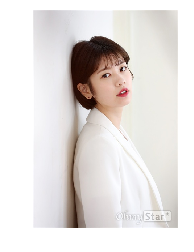

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\400.jpg


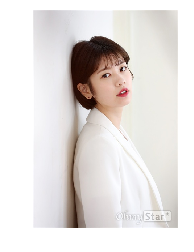

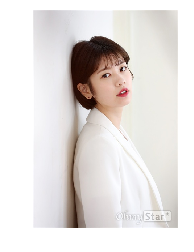

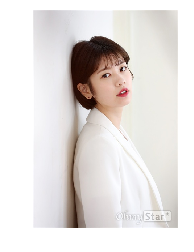

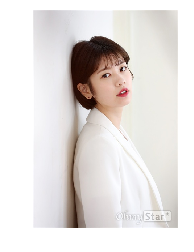

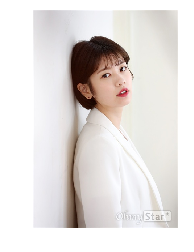

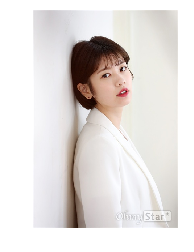

109 109
395 395
414 414
90 90
224 224
226 226
180 180
326 326
156 156
148 148
167 167
530 530
347 347
187 187
147 147
537 537
112 112
176 176
219 219
99 99
186 186
107 107
204 204
1178 1178
235 235
176 176
520 520
234 234
381 381
268 268
424 424
512 512


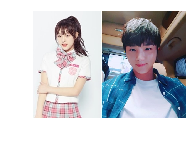

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\429.jpg


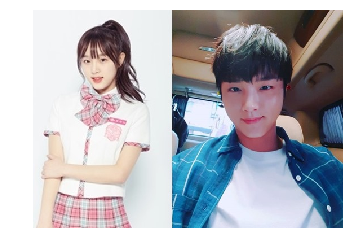

80 80
161 161
185 185
166 166
190 190
226 226
147 147
123 123
175 175


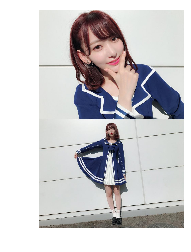

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\436.jpg


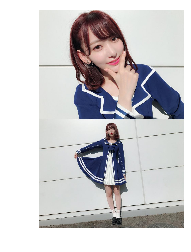

322 322
112 112
220 220
274 274


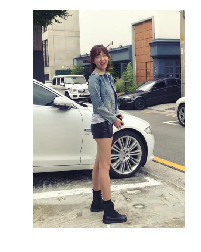

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\44.jpg


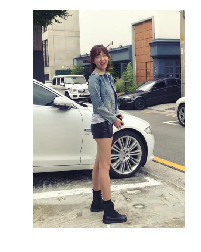

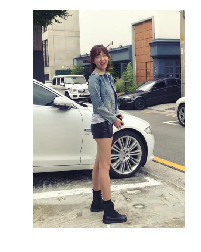

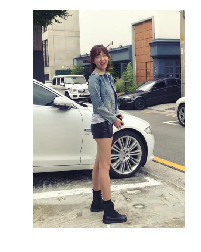

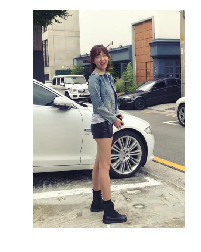

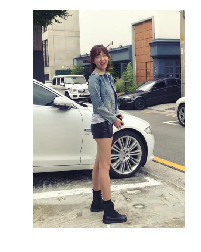

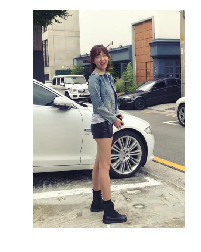

304 304
225 225


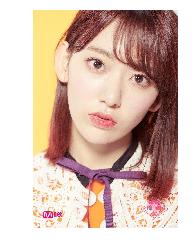

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\442.jpg


545 545


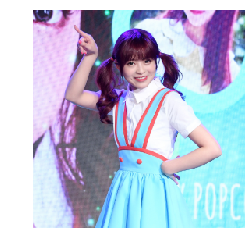

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\443.png


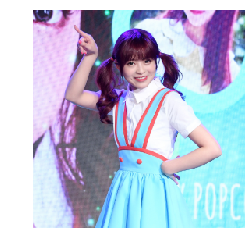

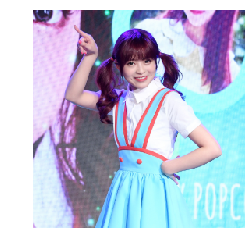

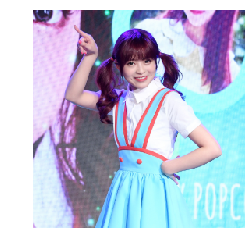

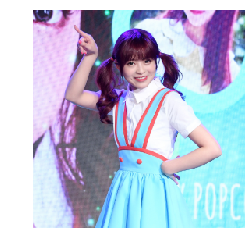

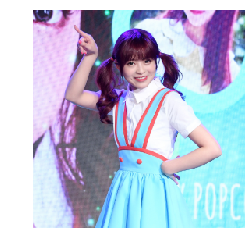

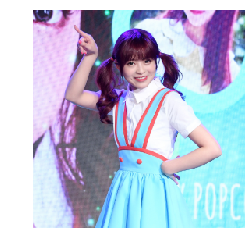

298 298
303 303


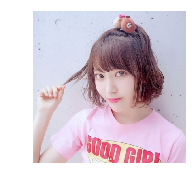

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\446.jpg


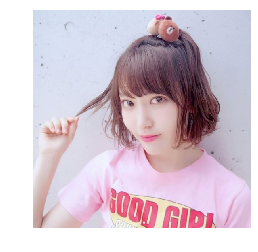

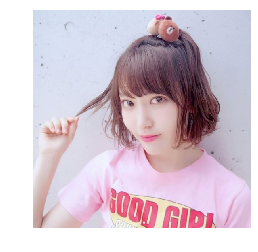

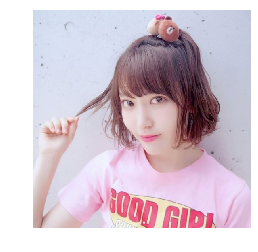

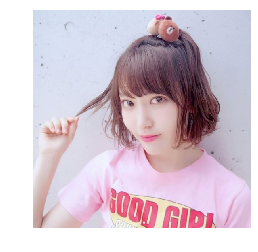

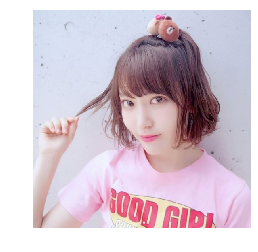

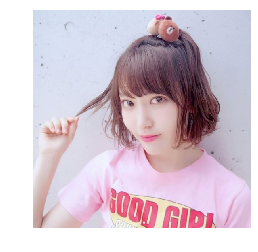

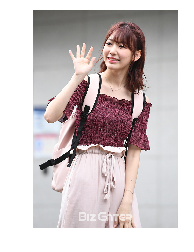

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\447.jpg


161 161
409 409
333 333
243 243
211 211
265 265


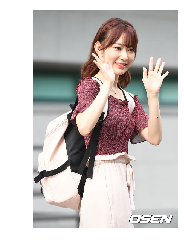

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\452.jpg


161 161
279 279
95 95
255 255
226 226
80 80
248 248
103 103
253 253
239 239
209 209
928 928
299 299
104 104
367 367
289 289


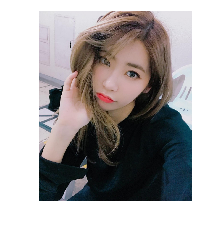

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\467.jpg


473 473
304 304
161 161
167 167
161 161
158 158
230 230
167 167
89 89


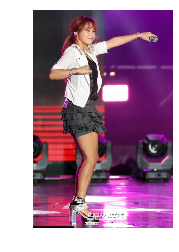

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\477.jpeg


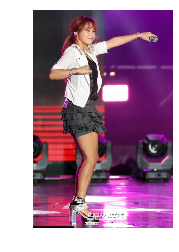

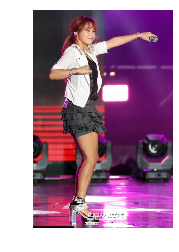

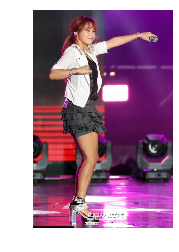

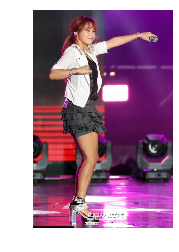

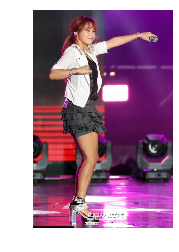

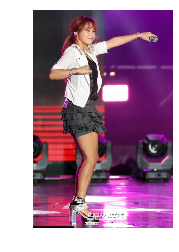

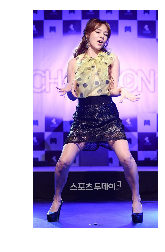

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\478.jpg


98 98
214 214
332 332
336 336
180 180
109 109
104 104
90 90
220 220
220 220
90 90
435 435
561 561
452 452
122 122
147 147
107 107
396 396
360 360
302 302
318 318
493 493
104 104
197 197
244 244
433 433
210 210
90 90
259 259
182 182
278 278


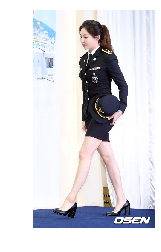

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\509.jpg


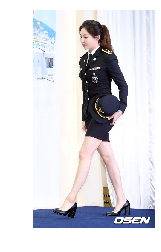

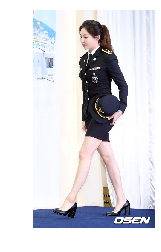

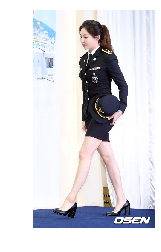

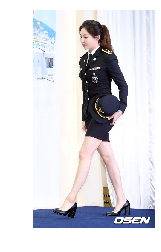

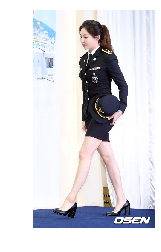

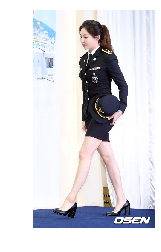

177 177


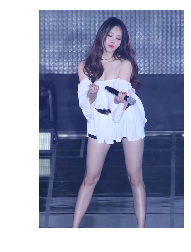

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\510.jpg


170 170
122 122


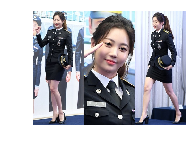

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\512.jpg


187 187
98 98
177 177
171 171
143 143
201 201


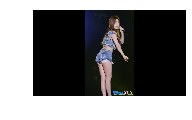

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\519.jpg


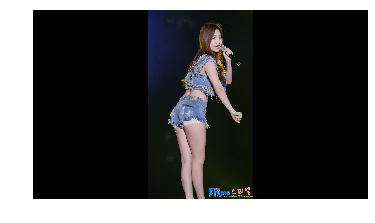

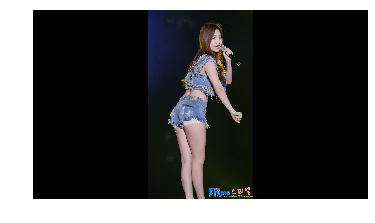

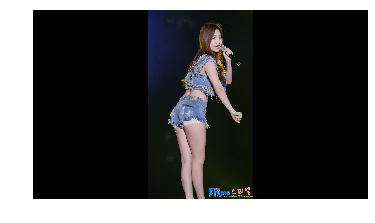

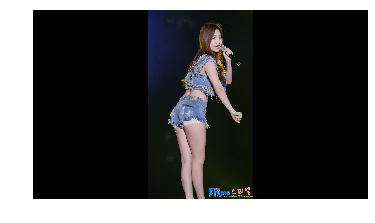

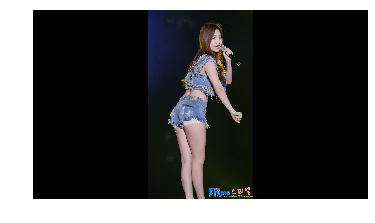

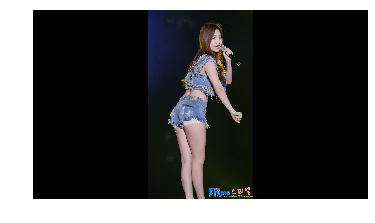

643 643
94 94
279 279


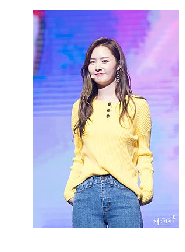

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\522.jpg


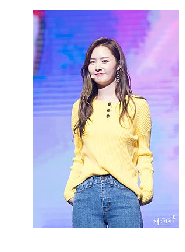

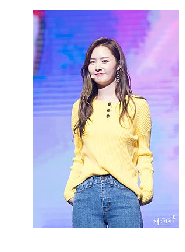

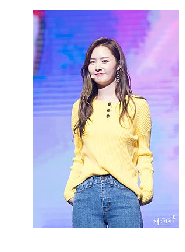

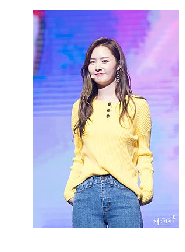

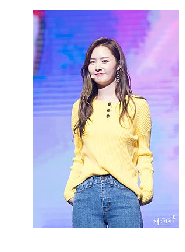

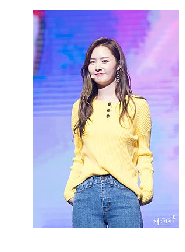

331 331
132 132
157 157
182 182
283 283
177 177
171 171
175 175
108 108
112 112
185 185
107 107
221 221
158 158


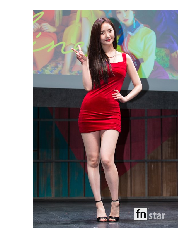

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\538.jpg


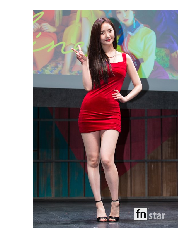

85 85
294 294
182 182
274 274
260 260
161 161


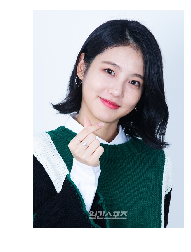

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\543.jpeg


287 287
355 355
303 303
395 395
167 167
326 326
278 278
491 491


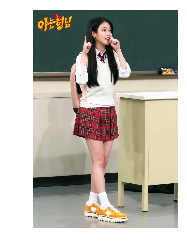

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\549.png


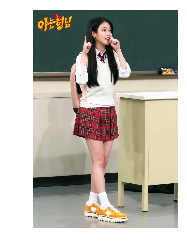

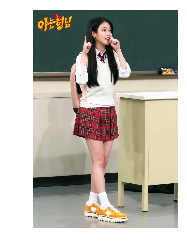

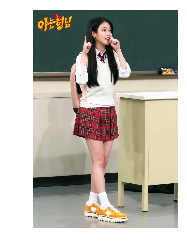

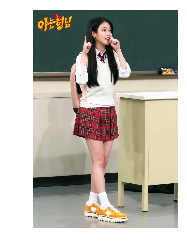

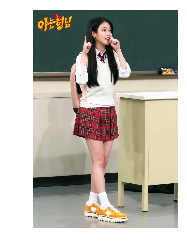

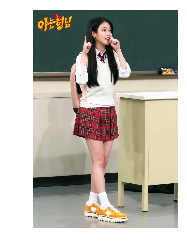

303 303
248 248


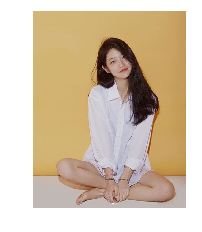

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\551.jpg


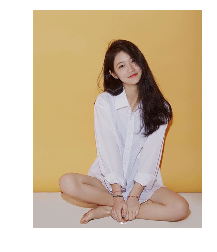

114 114


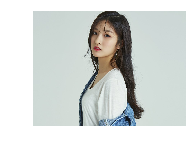

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\552.jpg


283 283
254 254
205 205
99 99
459 459
342 342


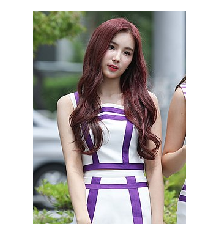

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\558.jpg


83 83
137 137
522 522
298 298
317 317
263 263
180 180
201 201
215 215
234 234
113 113


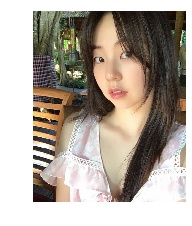

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\568.jpg


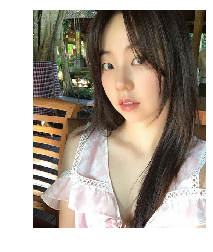

263 263
1654 1654


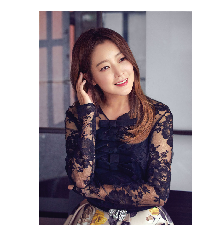

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\57.png


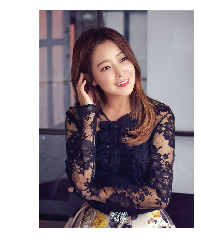

341 341
98 98
361 361
340 340
268 268
84 84
200 200


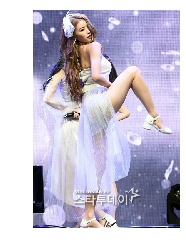

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\576.jpg


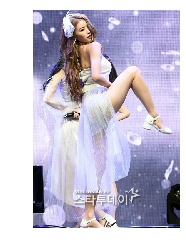

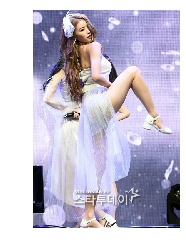

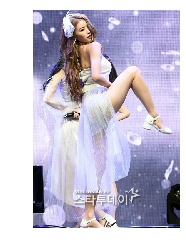

84 84
162 162
177 177
254 254
163 163


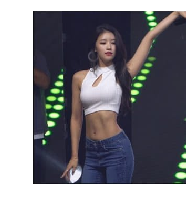

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\580.jpg


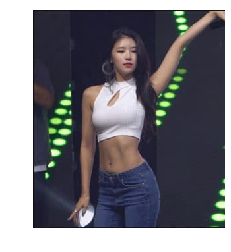

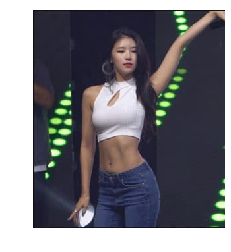

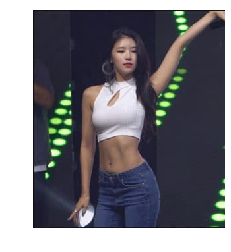

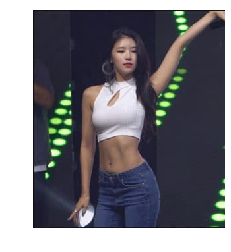

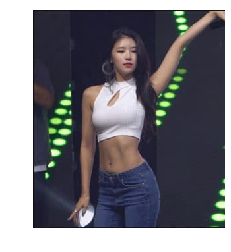

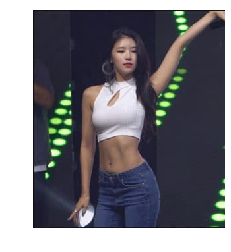

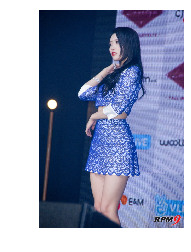

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\581.jpg


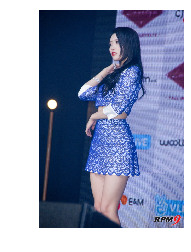

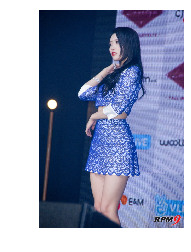

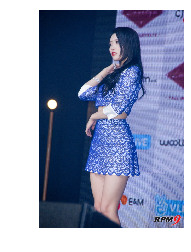

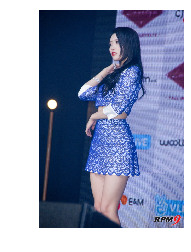

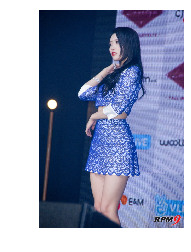

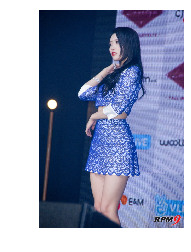

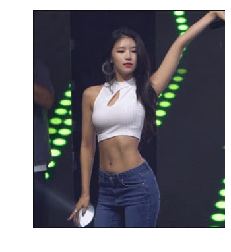

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\582.jpg


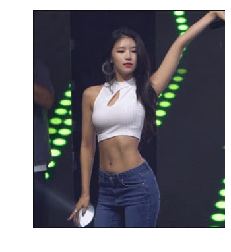

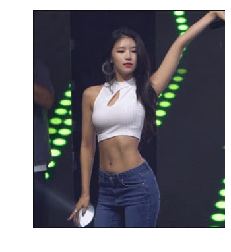

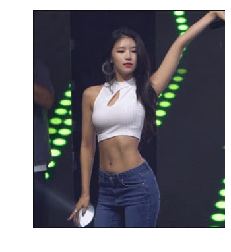

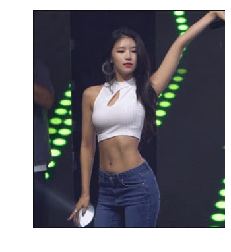

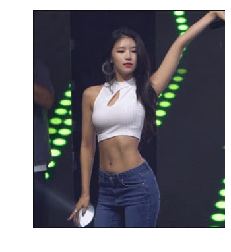

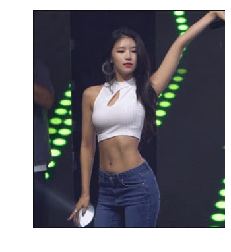

298 298
395 395
141 141


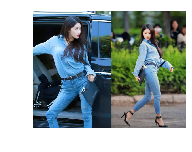

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\586.jpg


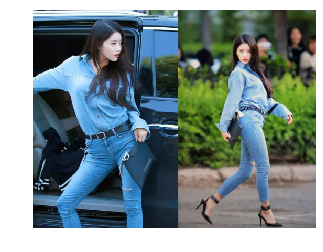

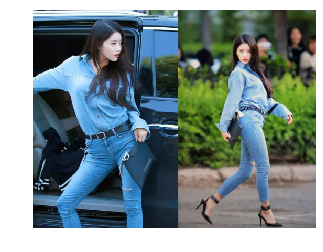

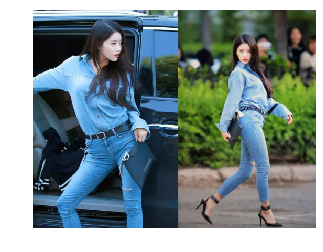

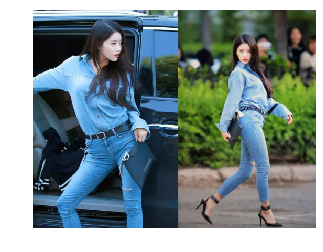

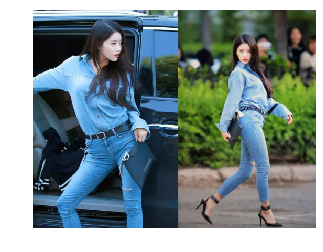

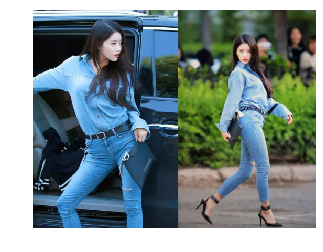

117 117
517 517
102 102


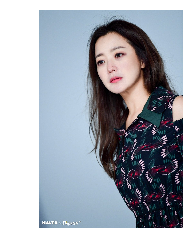

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\59.jpg


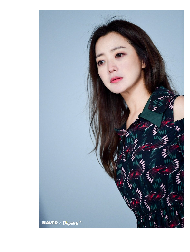

366 366
112 112
89 89
498 498
459 459
204 204


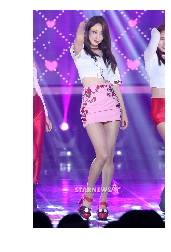

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\595.jpg


89 89


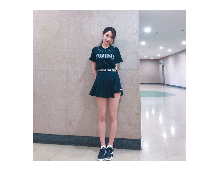

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\596.png


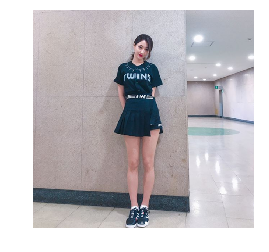

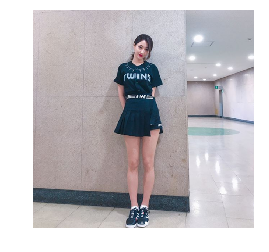

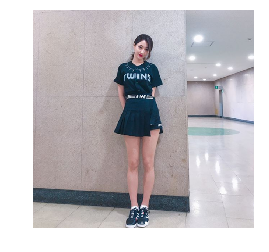

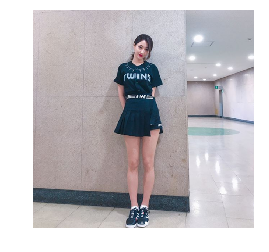

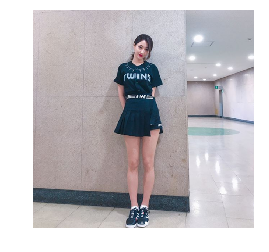

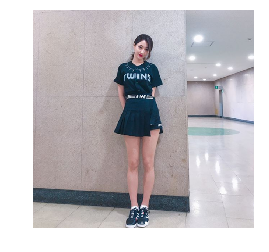

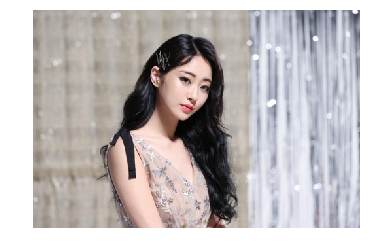

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\597.jpg


102 102
347 347
80 80
214 214
420 420
259 259


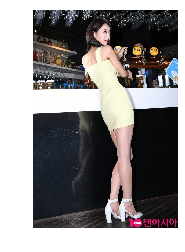

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\601.jpg


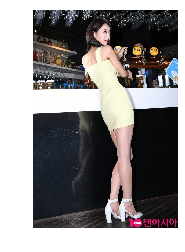

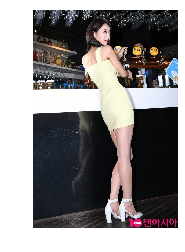

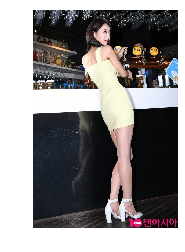

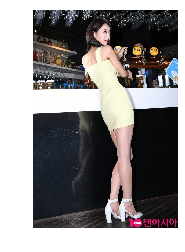

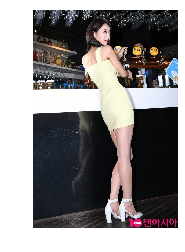

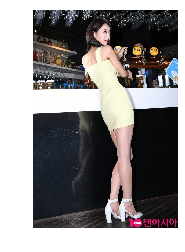

141 141
200 200
112 112
170 170


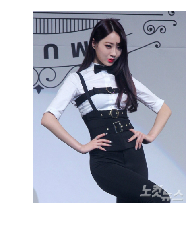

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\607.jpg


89 89


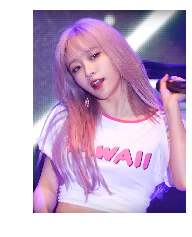

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\608.jpg


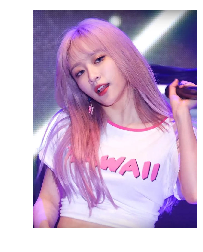

284 284
302 302
157 157
443 443
122 122
152 152
395 395


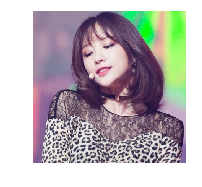

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\614.jpg


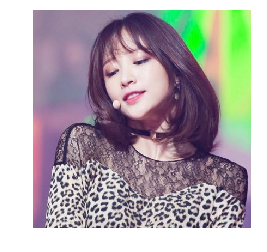

167 167
345 345
360 360
328 328
147 147
389 389
109 109
234 234


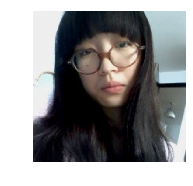

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\621.JPG


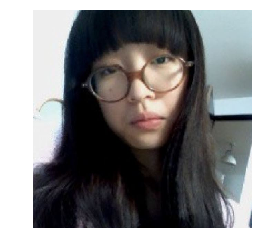

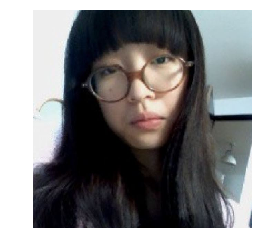

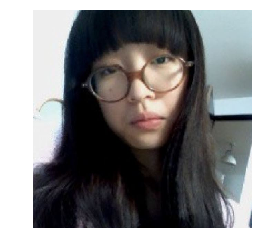

264 264
180 180


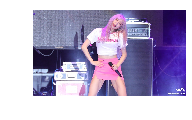

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\623.jpg


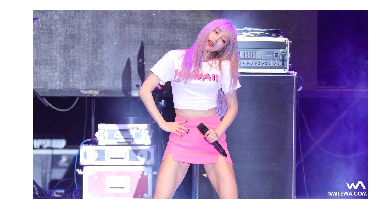

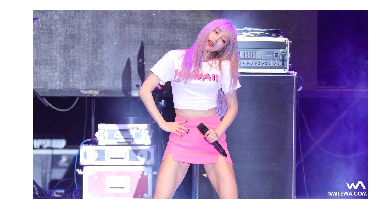

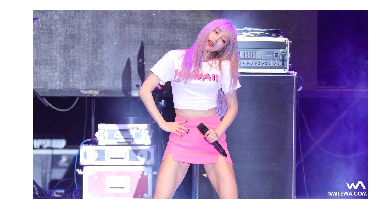

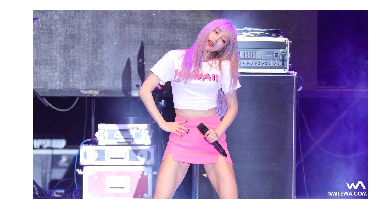

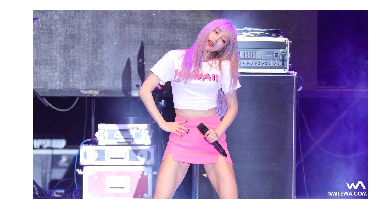

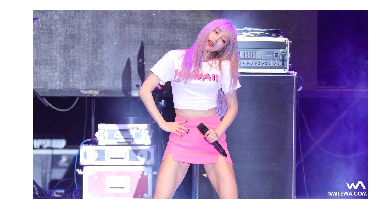

351 351
365 365
415 415
492 492
311 311
277 277
321 321
292 292
272 272
391 391


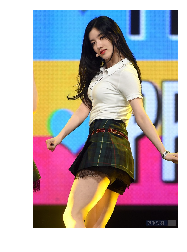

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\633.jpg


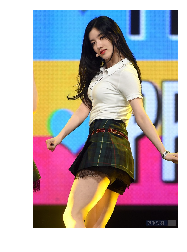

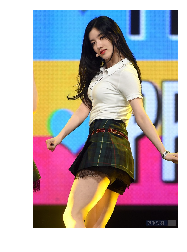

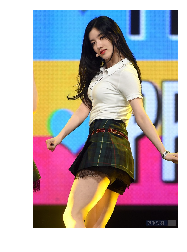

156 156
196 196
342 342


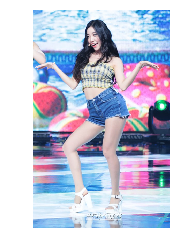

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\636.jpeg


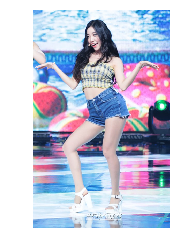

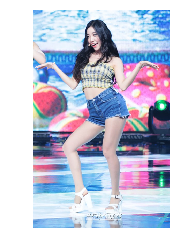

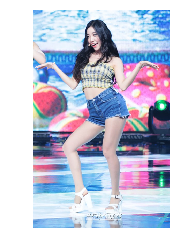

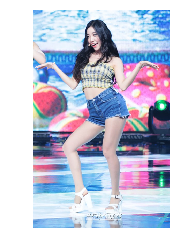

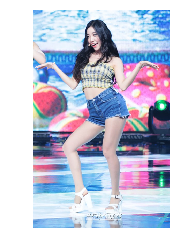

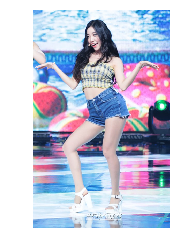

166 166
265 265
171 171
389 389
220 220
248 248
452 452
102 102
206 206
488 488
221 221


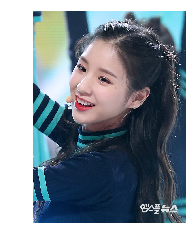

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\647.jpg


293 293
575 575
244 244
269 269
185 185
191 191


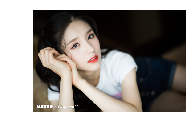

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\653.jpg


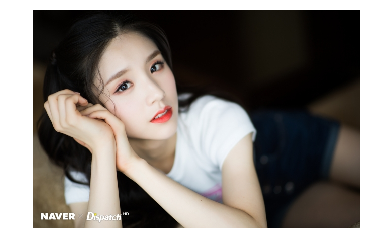

197 197
220 220


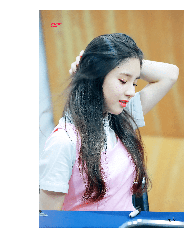

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\655.png


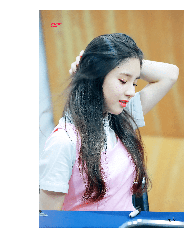

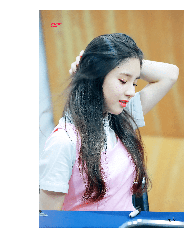

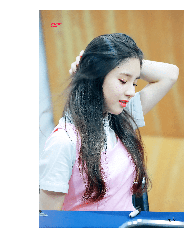

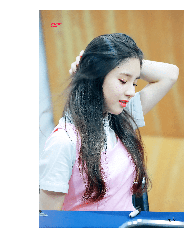

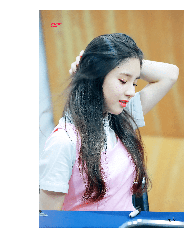

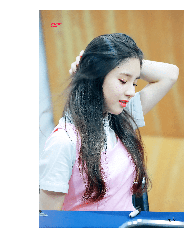

410 410
1448 1448
195 195
362 362
317 317
102 102


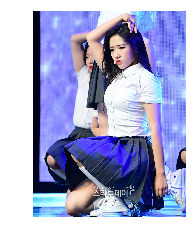

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\661.jpg


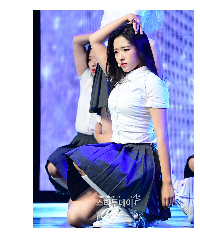

136 136
253 253
292 292
564 564
341 341
244 244


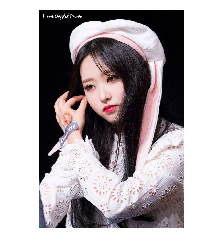

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\668.jpg


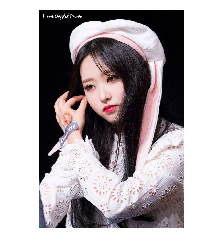

371 371
370 370
177 177
249 249
294 294


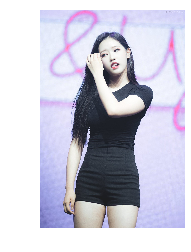

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\673.jpg


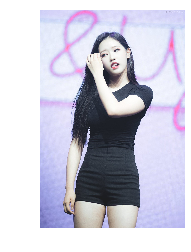

327 327
321 321
337 337
333 333
435 435
289 289


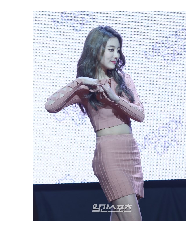

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\679.jpeg


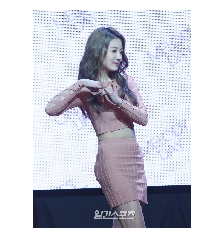

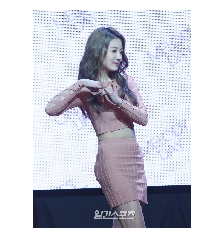

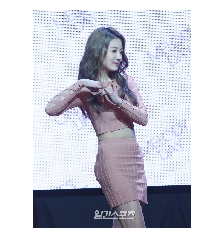

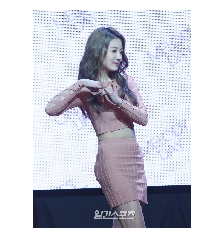

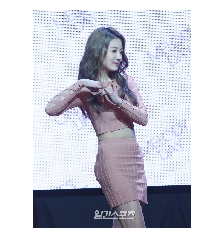

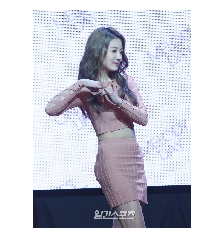

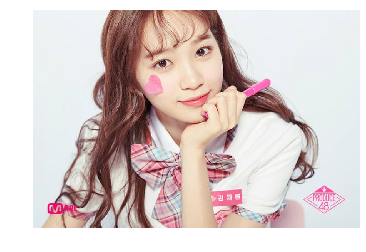

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\68.jpg


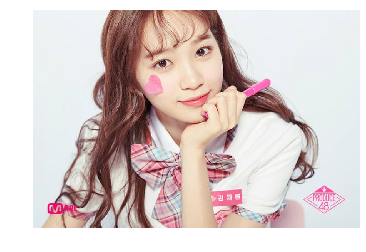

294 294
195 195
1191 1191
287 287
243 243


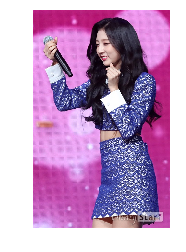

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\684.jpg


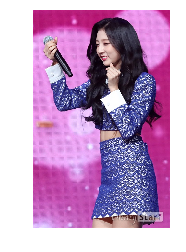

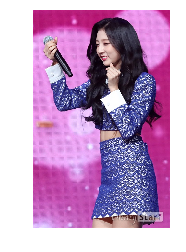

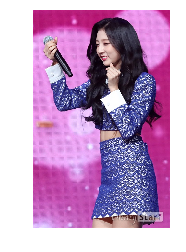

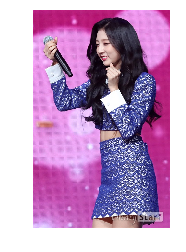

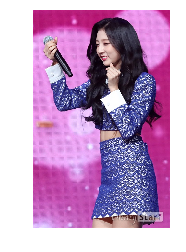

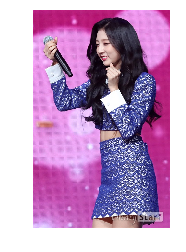

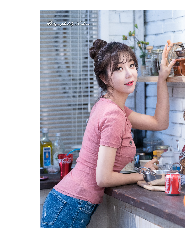

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\685.jpg


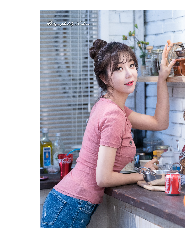

415 415
449 449


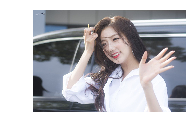

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\687.jpg


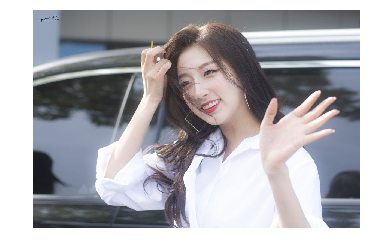

268 268


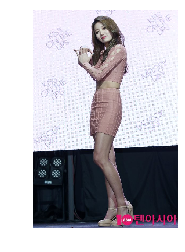

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\688.jpg


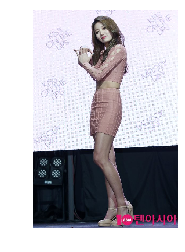

83 83
205 205
240 240


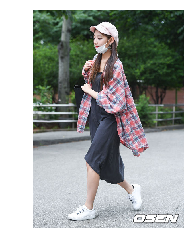

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\690.jpg


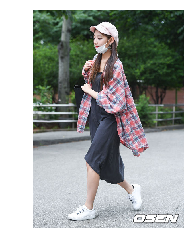

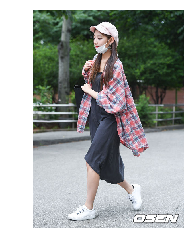

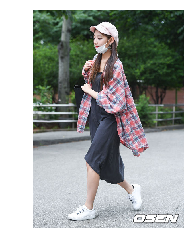

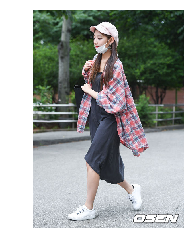

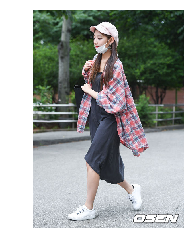

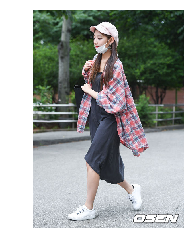

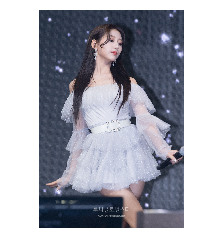

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\691.jpg


167 167


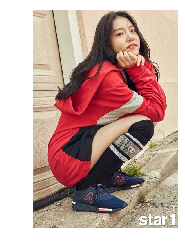

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\692.jpg


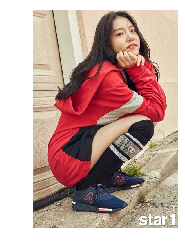

147 147


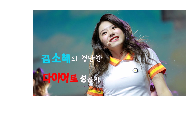

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\693.jpg


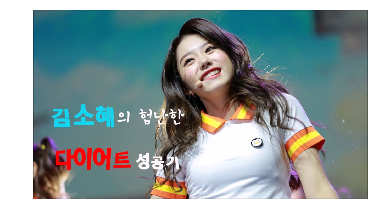

250 250
263 263
269 269
617 617
185 185
211 211
274 274
239 239
302 302
486 486
200 200
453 453
617 617
163 163
192 192
282 282
88 88
748 748
88 88
219 219


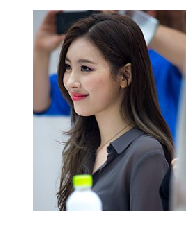

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\711.jpg


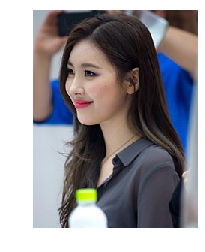

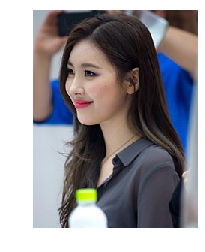

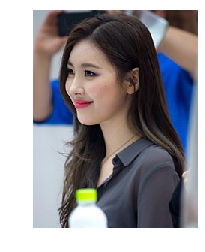

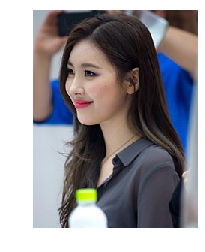

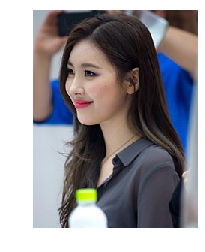

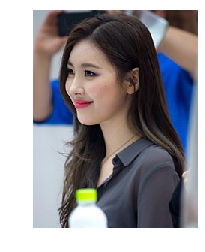

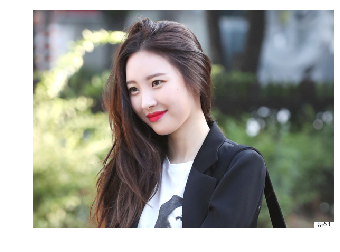

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\712.jpg


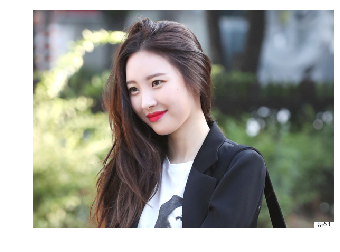

153 153
210 210
109 109
243 243
93 93
302 302
234 234
292 292
187 187


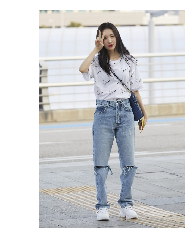

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\720.jpg


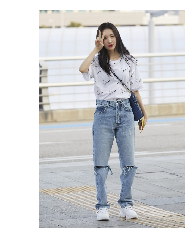

104 104
170 170
216 216
104 104


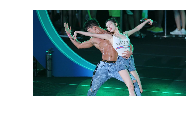

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\724.jpg


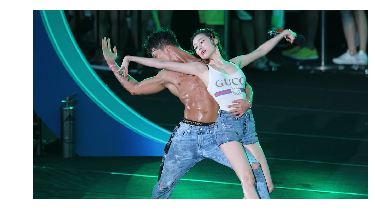

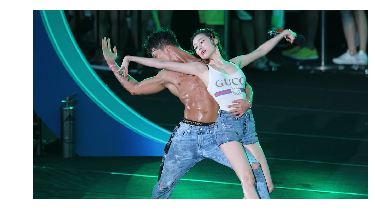

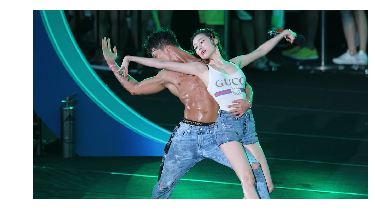

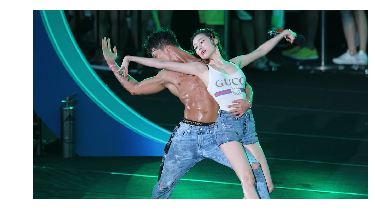

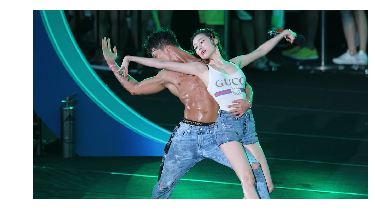

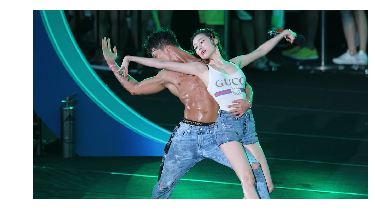

245 245
163 163
195 195
531 531
172 172
235 235
420 420
1406 1406
574 574
170 170
473 473
430 430


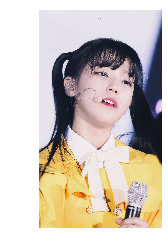

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\737.jpg


400 400
928 928
226 226
289 289
600 600
278 278
454 454
239 239
93 93
352 352
308 308


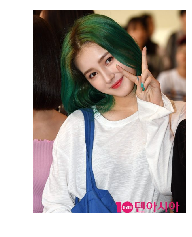

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\748.jpg


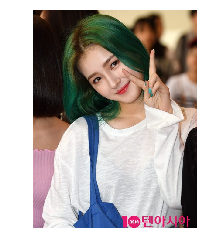

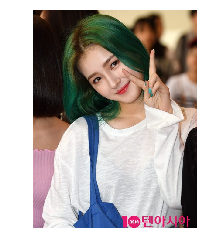

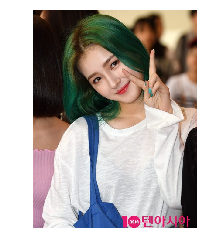

201 201


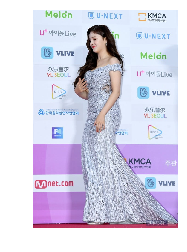

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\749.jpg


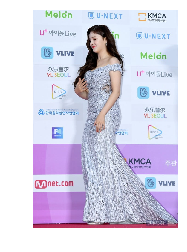

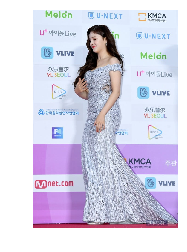

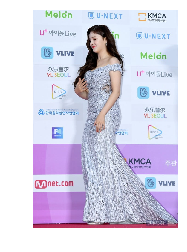

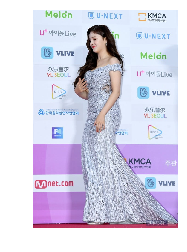

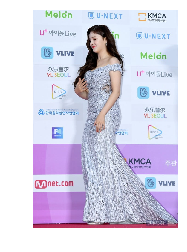

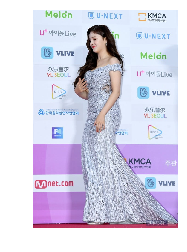

255 255
94 94
238 238


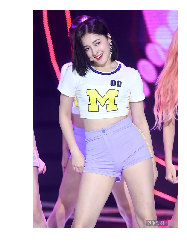

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\752.jpg


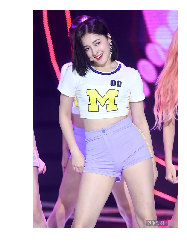

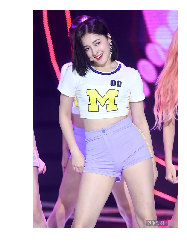

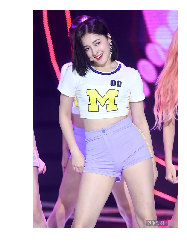

163 163
201 201
128 128
282 282


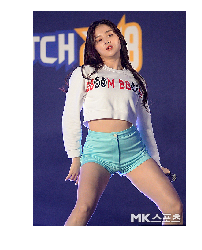

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\756.jpeg


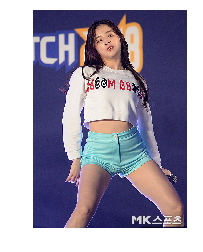

104 104


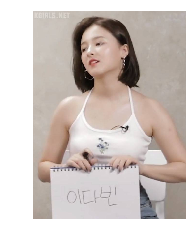

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\757.jpg


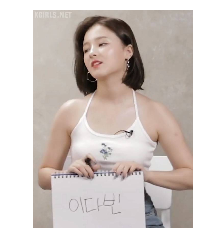

210 210
239 239


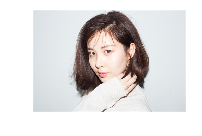

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\759.jpg


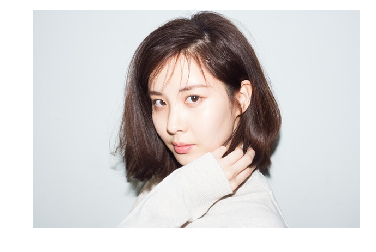

195 195
192 192
206 206
225 225
211 211
298 298
302 302
200 200
274 274
230 230
278 278
293 293
254 254
288 288
287 287
304 304
196 196
84 84
191 191
243 243
124 124
109 109
161 161
240 240
322 322
277 277
176 176
425 425
272 272
274 274
231 231
282 282
287 287
283 283
370 370
355 355
307 307
410 410
138 138
254 254
355 355
177 177
264 264
283 283
175 175
210 210


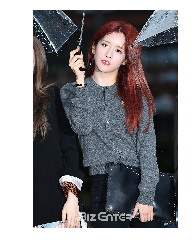

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\798.jpg


177 177
333 333
245 245
195 195
268 268


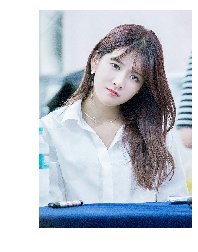

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\802.jpg


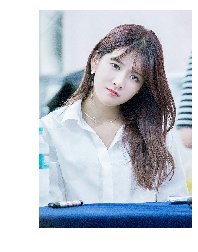

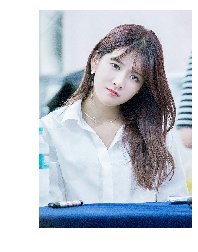

302 302
419 419
321 321


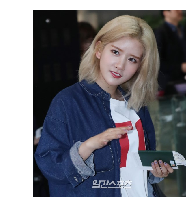

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\805.jpeg


191 191
274 274
172 172
225 225
162 162
322 322
147 147
209 209
477 477
284 284
197 197
200 200
229 229
404 404
298 298
594 594
302 302
93 93
603 603
394 394
234 234
234 234


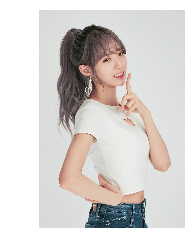

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\824.jpg


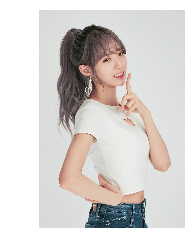

384 384
201 201
220 220
224 224
288 288
263 263
225 225


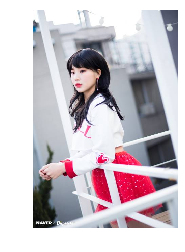

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\830.jpg


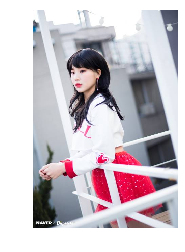

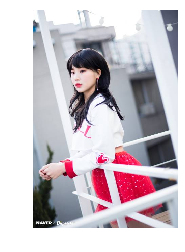

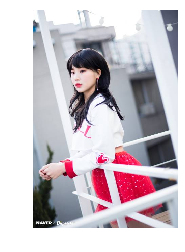

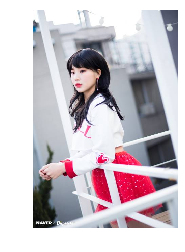

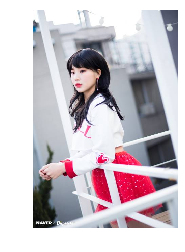

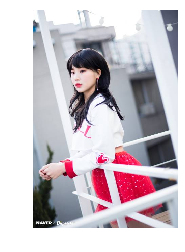

215 215
234 234
225 225
118 118
206 206


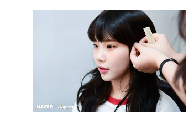

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\836.jpg


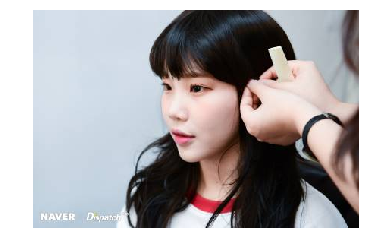

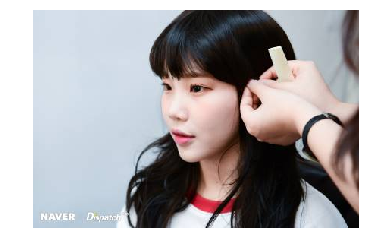

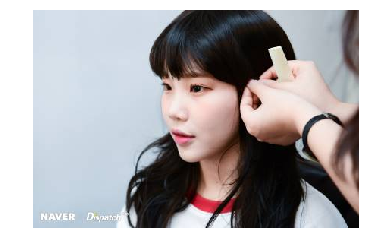

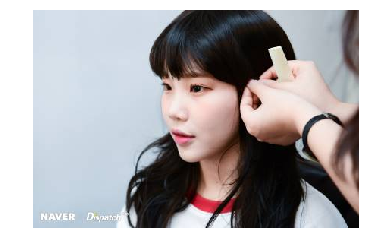

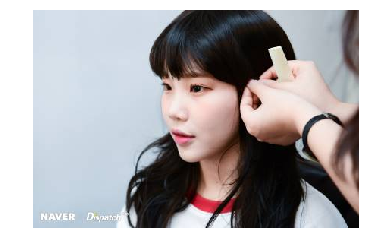

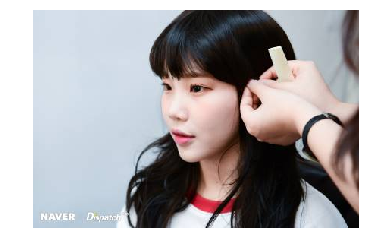

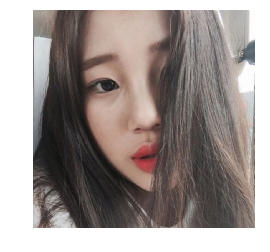

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\837.jpg


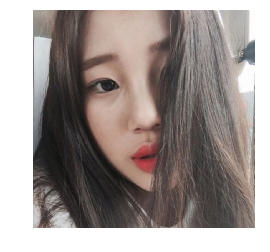

748 748
274 274
192 192
226 226


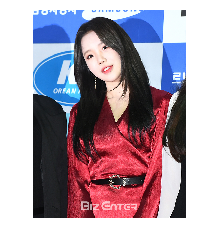

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\840.jpg


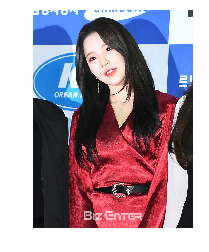

201 201
303 303
152 152
376 376
102 102
214 214
89 89
220 220
244 244


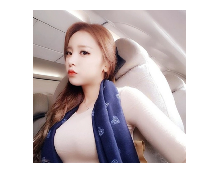

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\848.png


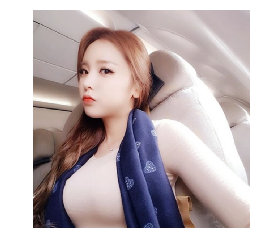

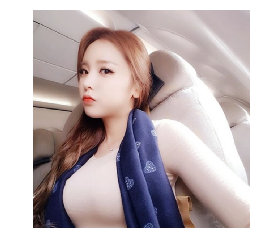

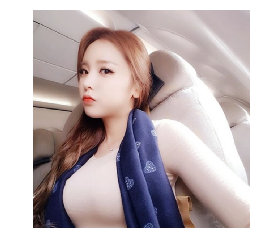

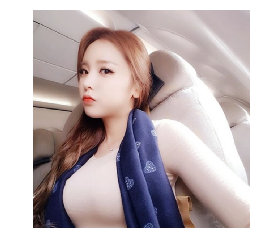

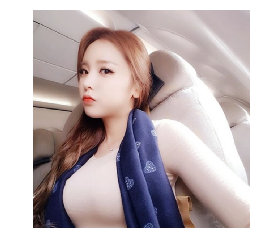

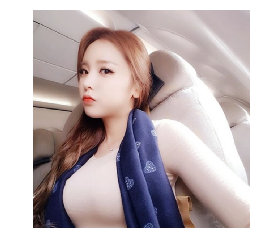

93 93
172 172
253 253
85 85
157 157
119 119
142 142
250 250
254 254
200 200


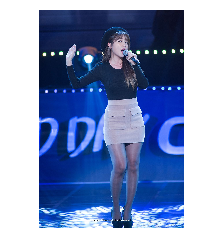

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\859.jpg


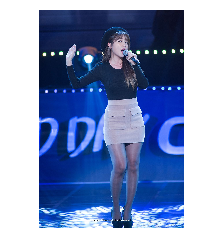

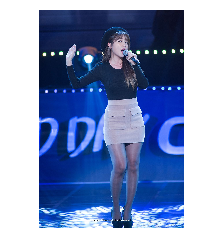

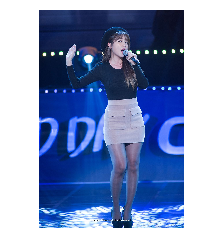

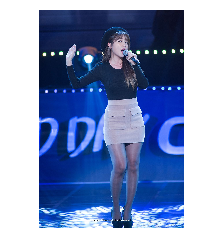

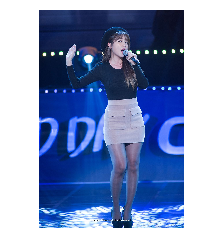

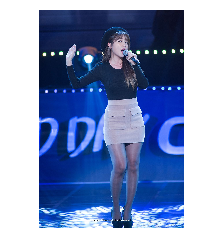

297 297
196 196
604 604
109 109
166 166
352 352
478 478
250 250
287 287
170 170


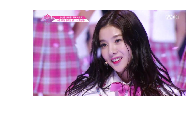

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\87.png


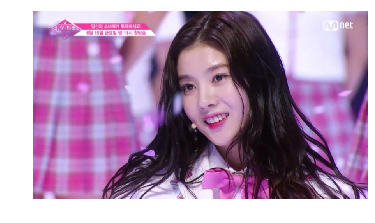

263 263
249 249
243 243
478 478
341 341
540 540
195 195
304 304


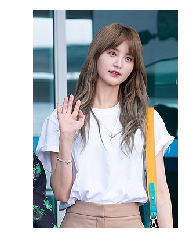

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\877.jpg


89 89
316 316
235 235
265 265
93 93
316 316
180 180


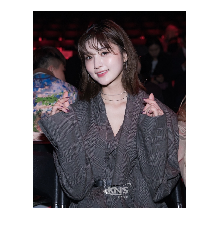

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\883.jpg


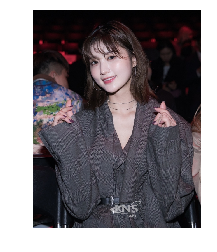

197 197
351 351
238 238
225 225
153 153
258 258
201 201
569 569
90 90
177 177
419 419
191 191
214 214
206 206
253 253
350 350
79 79
469 469
158 158
272 272
379 379
118 118
141 141
163 163
162 162
311 311
366 366
204 204


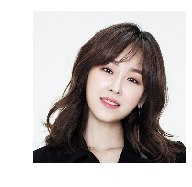

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\906.jpg


172 172
442 442
250 250
367 367
151 151
215 215
177 177


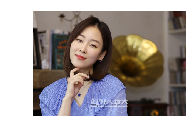

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\912.jpg


167 167
235 235
230 230
360 360
284 284
119 119
177 177
79 79
153 153
245 245
284 284
176 176


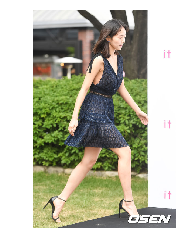

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\924.jpg


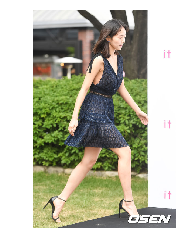

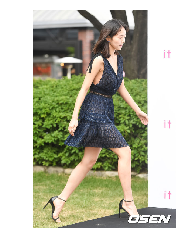

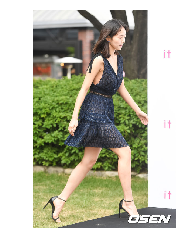

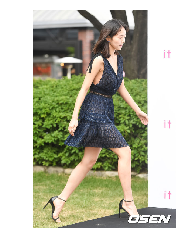

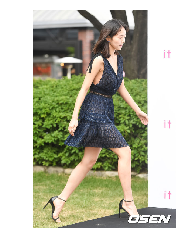

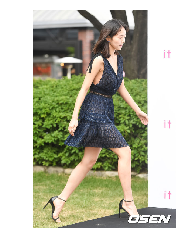

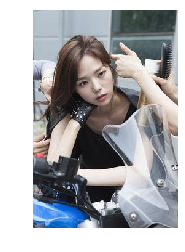

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\925.jpg


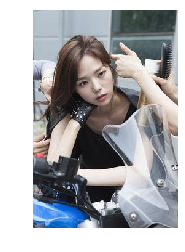

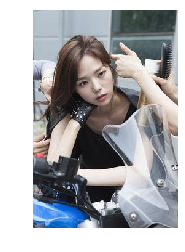

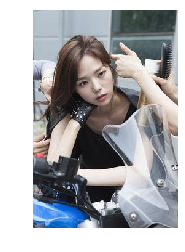

93 93
313 313
279 279
245 245
259 259
93 93
248 248
158 158
181 181
230 230
146 146
250 250
89 89
133 133
187 187
170 170
418 418
497 497
78 78


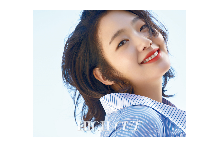

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\942.png


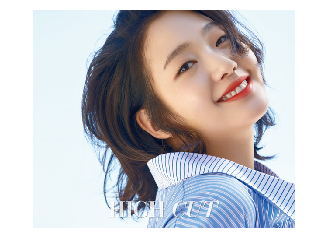

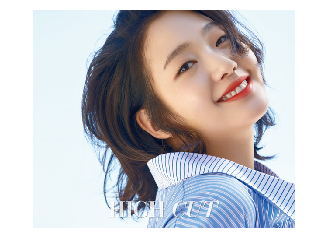

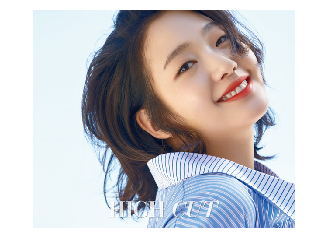

336 336
355 355
491 491
476 476
195 195


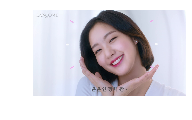

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\947.jpg


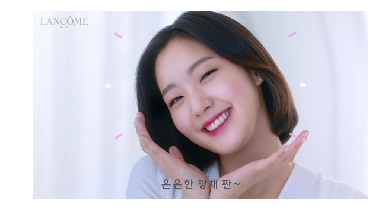

298 298
181 181
433 433
185 185
293 293
182 182


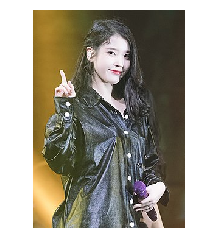

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\952.jpg


79 79
268 268
215 215
355 355
84 84
298 298
129 129
278 278
264 264


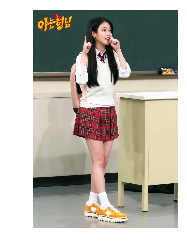

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\961.png


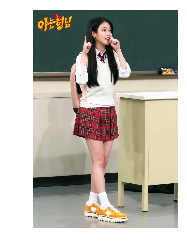

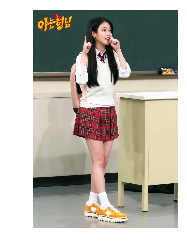

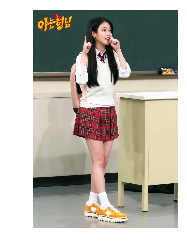

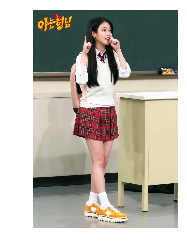

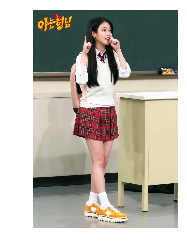

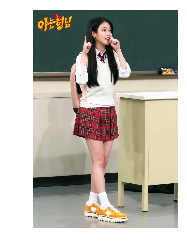

600 600
259 259
254 254
205 205
99 99
294 294
274 274
260 260


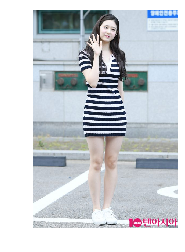

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\97.jpg


88 88
161 161


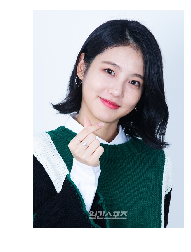

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\971.jpeg


287 287
303 303
395 395
167 167
326 326
278 278
491 491
248 248
409 409
340 340
258 258


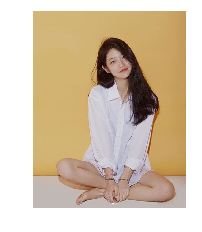

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\981.jpg


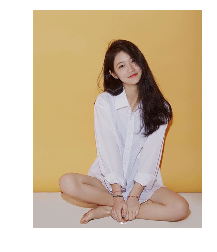

114 114


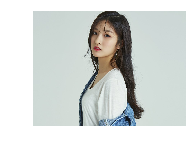

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\982.jpg


283 283
98 98
323 323
366 366
234 234
245 245
187 187


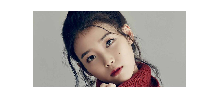

C:\Users\Jonathan\Anaconda3\envs\snowflake\lib\site-packages\ipykernel_launcher.py:163: RuntimeWarning: Could not find face in C:/Users/Jonathan/Documents/development/datasets/images/kceleb/female\iu_1478147965_af_org.jpg


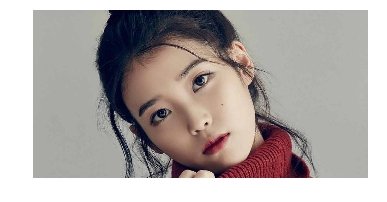

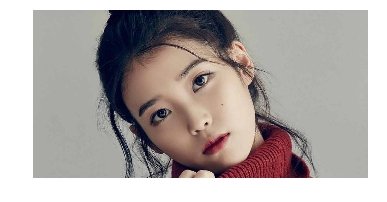

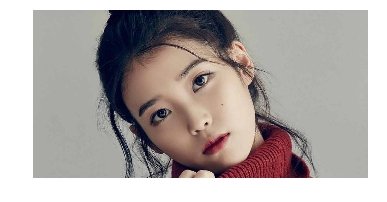

449 449
221 221
255 255
283 283


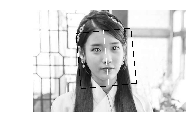

In [4]:
if os.path.exists(result_dir):
    os.remove(result_dir)
os.makedirs(result_dir)

#Iterate through each picture
for i, image_file in enumerate(file_list):

    #read image in grayscale (flag 0)
    img_c = cv2.imread(image_file)
    img_g = cv2.cvtColor(img_c, cv2.COLOR_BGR2GRAY)

    (height, width) = img_g.shape[:2]

    #Keep track of whether we found a face or not
    found_face = False

    for theta in [0, 15, -15, 30, -30, 90, -90]:
        rotated = imutils.rotate(img_c, theta)
        rotated_g = imutils.rotate(img_g, theta)

        face_cascade = cv2.CascadeClassifier(lbp_xml)
        faces = face_cascade.detectMultiScale(
          rotated_g,
          scaleFactor=1.1,
          minNeighbors=5,
          minSize=(30, 30)
        )

        if len(faces):
            found_face = True

            for (fx, fy, fw, fh) in faces:
                fx -= int(fw * MARGIN)
                fy -= int(fh * MARGIN)
                fw += 2 * int(fw * MARGIN)
                fh += 2 * int(fh * MARGIN)
                
                print(fw, fh)
                cropped = rotated[fy:fy+fh, fx:fx+fw] #crop face

                eye_cascade = cv2.CascadeClassifier(eye_xml)
                eyes = eye_cascade.detectMultiScale(cropped, minSize=(10, 10))

                #If we found (at least) a pair of eyes...
                if len(eyes) >= 2:
                    #Sort eyes by the y value 
                    eyes = eyes[eyes[:,1].argsort()]

                    #Get the highest two points -- these should be the actual eyes;
                    #if more are detected, they're usually nose holes or in the teeth
                    left_eye = eyes[0]
                    right_eye = eyes[1]
                    #Make sure the left eye is on the left
                    if left_eye[0] > right_eye[0]:
                        left_eye, right_eye = right_eye, left_eye

                #Draw a circle in each eye (in color)
                eye_centers = []
                for (eye_x, eye_y, eye_w, eye_h) in (left_eye, right_eye):
                    eye_x, eye_y = eye_x + fx, eye_y + fy #add offset from face

                    #Get the centers of each eye
                    center_x = eye_x + (eye_w // 2)
                    center_y = eye_y + (eye_h // 2)
                    eye_centers.append((center_x, center_y))

                    #Draw circles in the eyes
                    #cv2.circle(rotated, (center_x, center_y), 4, (255, 0, 0), -1)

                    x_coords = [center_x]
                    y_coords = [center_y]
                    pts = rotate_points(x_coords, y_coords, img_g.shape[:2], -(theta))
                    rotated_x = pts[0, 0]
                    rotated_y = pts[0, 1]
                    cv2.circle(img_g, (rotated_x, rotated_y), 4, (200, 0, 200), -1)


                #Find the angle between the eyes
                (cx_l, cy_l) = eye_centers[0]
                (cx_r, cy_r) = eye_centers[1]
                slope = (cy_r - cy_l) / (cx_r - cx_l)
                if (slope == np.inf):
                    break
                    
                align_angle = np.arctan(slope)
                
                #Calculate the midpoint between the eyes
                mid_x = (cx_l + cx_r) // 2
                mid_y = (cy_l + cy_r) // 2

                #Draw a line using the angle perpendicular to the alignment angle
                perp_angle = align_angle + (np.pi/2)
                p1, p2 = point_angle_line(mid_x, mid_y, perp_angle, fy, fy+fh)
                #cv2.line(rotated, p1, p2, (0, 255, 0), 2)

                #Get angle in degrees
                align_angle_deg = np.rad2deg(align_angle)

                #Rotate the image to align
                rotated = imutils.rotate(rotated, align_angle_deg)

                #Rotate the box about the center of the image
                x_coords = [0, 0, fw, fw] + fx
                y_coords = [0, fh, fh, 0] + fy
                pts = rotate_points(x_coords, y_coords, img_g.shape[:2], align_angle_deg)

                #Rotate the box about the center of the box
                x_coords, y_coords = pts[:,0], pts[:,1]
                new_fx, new_fy = min(x_coords), min(y_coords)
                x_coords -= new_fx
                y_coords -= new_fy
                pts = rotate_points(x_coords, y_coords, (max(y_coords), max(x_coords)), -align_angle_deg)
                pts[:,0] += new_fx
                pts[:,1] += new_fy

                #Crop the photo to the aligned box
                lower_x, upper_x = min(pts[:,0]), max(pts[:,0])
                lower_y, upper_y = min(pts[:,1]), max(pts[:,1])
                crop_width = upper_x - lower_x
                crop_height = upper_y - lower_y
                upper_x -= crop_width - crop_height #make it a square
                cropped = rotated[lower_y:upper_y, lower_x:upper_x]

                #Draw a rectangle around the colored face (rotate in place; then rotate wrt image)          
                x_coords = [0, 0, fw, fw] 
                y_coords = [0, fh, fh, 0] 
                pts = rotate_points(x_coords, y_coords, (fh, fw), -align_angle_deg)
                pts[:,0] += fx
                pts[:,1] += fy
                x_coords, y_coords = list(pts[:-1,0]), list(pts[:-1,1])
                pts = rotate_points(x_coords, y_coords, img_g.shape[:2], -theta)
                cv2.polylines(img_g, [pts], False, (0, 255, 0), 2)

                #Draw the line separating the face
                x_coords = [p1[0], p2[0]]
                y_coords = [p1[1], p2[1]]
                pts = rotate_points(x_coords, y_coords, img_g.shape[:2], -theta)
                x_coords, y_coords = pts[:-1,0], pts[:-1,1]
                p1 = (x_coords[0], y_coords[0])
                p2 = (x_coords[1], y_coords[1])
                cv2.line(img_g, p1, p2, (255, 0, 0), 2)
            
            if cropped.shape[0] == 0 or cropped.shape[1] == 0:
                break
            cropped = cv2.resize(cropped, (CROP_SIZE, CROP_SIZE))

            cv2.imwrite(os.path.join(result_dir, f'{i}.png'), cropped)
            #Show the colored face with markers
            plt.subplot(1, 2, 1)
            plt.imshow(img_g, cmap='gray')
            plt.axis('off')
#             plt.subplot(1, 2, 2)
#             plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
#             plt.axis('off')
#             plt.show()

            break

        if not found_face:
            plt.imshow(cv2.cvtColor(img_c, cv2.COLOR_BGR2RGB))
            plt.axis('off')
            plt.show()
            warnings.warn("Could not find face in {}".format(image_file), RuntimeWarning)
